<a href="https://colab.research.google.com/github/ccobopie/TFG-BA/blob/main/TFGParte1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Eliminar espacions CSV**

In [ ]:
import pandas as pd


def eliminar_espacios_en_df(df):
    # Eliminar espacios en las cadenas de cada columna
    for columna in df.columns:
        if df[columna].dtype == object:  # Verifica si la columna es de tipo objeto (cadena)
            df[columna] = df[columna].str.replace(' ', '', regex=False)
    return df

# Lista de tus archivos CSV
archivos_csv = ['Advanced.csv', 'Averages.csv', 'Misc.csv', 'FourFactors.csv','Differential.csv','Opponents.csv']

for archivo in archivos_csv:
    # Leer el archivo CSV
    df = pd.read_csv(archivo, delimiter=';')  # Asegúrate de usar el delimitador correcto

    # Eliminar espacios
    df = eliminar_espacios_en_df(df)

    # Guardar en un nuevo archivo CSV
    df.to_csv(f'procesado_{archivo}', index=False)




# **Combinar BBDD**

In [ ]:
import csv

def detectar_delimitador(file_name):
    with open(file_name, 'r') as file:
        sniffer = csv.Sniffer()
        dialect = sniffer.sniff(file.readline())
        return dialect.delimiter

def read_csv_and_print_columns(file_name):
    delimiter = detectar_delimitador(file_name)
    df = pd.read_csv(file_name, delimiter=delimiter)
    print(f"Columns in {file_name}: {df.columns.tolist()}")
    return df

# Leer los archivos CSV y mostrar las columnas
advanced = read_csv_and_print_columns('procesado_Advanced.csv')
averages = read_csv_and_print_columns('procesado_Averages.csv')
misc = read_csv_and_print_columns('procesado_Misc.csv')
four_factors = read_csv_and_print_columns('procesado_FourFactors.csv')
opponents = read_csv_and_print_columns('procesado_Opponents.csv')
differential = read_csv_and_print_columns('procesado_Differential.csv')

# Verificar que existan las columnas 'Team' y 'Season'
for df in [advanced, averages, misc, four_factors, opponents, differential]:
    if 'Team' not in df.columns or 'Season' not in df.columns:
        raise ValueError("One of the DataFrames is missing 'Team' or 'Season' column")

# Step 3: Merge the DataFrames
combined_df = advanced.merge(averages, on=['Team', 'Season'], how='outer')
combined_df = combined_df.merge(misc, on=['Team', 'Season'], how='outer')
combined_df = combined_df.merge(four_factors, on=['Team', 'Season'], how='outer')
combined_df = combined_df.merge(differential, on=['Team', 'Season'], how='outer')
combined_df = combined_df.merge(opponents, on=['Team', 'Season'], how='outer')

# Step 4: Handle missing data
combined_df.fillna('NA', inplace=True)

# Optionally, save the combined DataFrame to a new CSV file
combined_df.to_csv('CombinedDatabase.csv', index=False)

display(combined_df)

Columns in procesado_Advanced.csv: ['Team', 'TS%', 'eFG%', 'Total S%', 'ORB%', 'DRB%', 'TRB%', 'AST%', 'TOV%', 'STL%', 'BLK%', 'PPS', 'FIC40', 'ORtg', 'DRtg', 'eDiff', 'Poss', 'Pace', 'Season']
Columns in procesado_Averages.csv: ['Team', 'GP', 'MPG', 'PPG', 'FGM', 'FGA', 'FG%', '3PM', '3PA', '3P%', 'FTM', 'FTA', 'FT%', 'ORB', 'DRB', 'RPG', 'APG', 'SPG', 'BPG', 'TOV', 'PF', 'Season']
Columns in procesado_Misc.csv: ['Team', 'Dbl Dbl', 'Tpl Dbl', '40 Pts', '20 Reb', '20 Ast', '5 Stl', '5 Blk', 'High Game', 'MOV', 'Techs', 'HOB', 'Ast/TO', 'Stl/TO', 'FT/FGA', "W's", "L's", 'Win %', 'Season']
Columns in procesado_FourFactors.csv: ['Team', 'Total MIN', 'EFG%', 'FTA RATE', 'TOV%', 'OREB%', 'OPP EFG%', 'OPP FTA RATE', 'OPP TOV%', 'OPP OREB%', 'Season']
Columns in procesado_Opponents.csv: ['Team', 'PTS/ OPP', 'FGM/ OPP', 'FGA/ OPP', 'FG%/ OPP', '3PM/ OPP', '3PA/ OPP', '3P%/ OPP', 'FTM/ OPP', 'FTA/ OPP', 'FT%/ OPP', 'OR/ OPP', 'DR/ OPP', 'REB/ OPP', 'AST/ OPP', 'STL/ OPP', 'BLK/ OPP', 'TO/ OPP',

,Team,TS%,eFG%,Total S%,ORB%,DRB%,TRB%,AST%,TOV%_x,STL%,...,FTA/ OPP,FT%/ OPP,OR/ OPP,DR/ OPP,REB/ OPP,AST/ OPP,STL/ OPP,BLK/ OPP,TO/ OPP,PF/ OPP
0,Boston,0.6,0.566,166.4,22.1,78.5,50.7,63.2,12.0,6.3,...,21.1,76.9,9.7,34.3,44.0,23.1,6.6,3.9,12.0,19.1
1,Cleveland,0.59,0.556,163.5,23.6,76.3,49.9,60.0,12.3,7.4,...,22.4,78.2,9.8,31.5,41.2,23.0,7.0,4.4,14.7,20.4
2,Philadelphia,0.608,0.563,170.9,21.6,77.2,49.9,61.6,12.6,7.9,...,23.7,78.1,9.5,31.6,41.2,24.2,6.6,4.6,13.5,19.6
3,Memphis,0.57,0.54,155.9,26.5,75.9,51.2,59.6,11.7,8.2,...,23.5,78.7,11.0,33.4,44.4,26.4,6.8,5.2,14.4,20.0
4,Milwaukee,0.583,0.555,158.3,25.0,77.8,52.4,60.4,12.7,6.3,...,21.0,77.6,10.7,33.5,44.2,23.9,7.0,3.9,11.5,19.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1633,Toronto,NA,NA,NA,NA,NA,NA,NA,NA,NA,...,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA
1634,NewYork,NA,NA,NA,NA,NA,NA,NA,NA,NA,...,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA
1635,Detroit,NA,NA,NA,NA,NA,NA,NA,NA,NA,...,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA
1636,Pittsburgh,NA,NA,NA,NA,NA,NA,NA,NA,NA,...,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA


# **Información General**

In [ ]:
import pandas as pd

# Leer el archivo CSV
datos = pd.read_csv('CombinedDatabase.csv')

# Número de observaciones y variables
num_observaciones = datos.shape[0]
num_variables = datos.shape[1]

# Crear una tabla con la información de las columnas
info_columnas = pd.DataFrame({
    'Columna': datos.columns,
    'Tipo de Dato': datos.dtypes,
    'Número de Observaciones': datos.notnull().sum(),  # Contar valores no nulos por columna
    'Ejemplo de Valor': datos.iloc[0]  # Muestra el primer valor de cada columna como ejemplo
})

# Mostrar la información general
print(f"Número de Observaciones: {num_observaciones}")
print(f"Número de Variables: {num_variables}")
print("\nInformación de las Columnas:")
print(info_columnas)
display(info_columnas)

Número de Observaciones: 1638
Número de Variables: 101

Información de las Columnas:
           Columna Tipo de Dato  Número de Observaciones Ejemplo de Valor
Team          Team       object                     1638           Boston
TS%            TS%      float64                     1349              0.6
eFG%          eFG%      float64                     1349            0.566
Total S%  Total S%      float64                     1349            166.4
ORB%          ORB%      float64                     1349             22.1
...            ...          ...                      ...              ...
AST/ OPP  AST/ OPP      float64                      657             23.1
STL/ OPP  STL/ OPP      float64                      657              6.6
BLK/ OPP  BLK/ OPP      float64                      657              3.9
TO/ OPP    TO/ OPP      float64                      657             12.0
PF/ OPP    PF/ OPP      float64                      657             19.1

[101 rows x 4 columns]


,Columna,Tipo de Dato,Número de Observaciones,Ejemplo de Valor
Team,Team,object,1638,Boston
TS%,TS%,float64,1349,0.6
eFG%,eFG%,float64,1349,0.566
Total S%,Total S%,float64,1349,166.4
ORB%,ORB%,float64,1349,22.1
...,...,...,...,...
AST/ OPP,AST/ OPP,float64,657,23.1
STL/ OPP,STL/ OPP,float64,657,6.6
BLK/ OPP,BLK/ OPP,float64,657,3.9
TO/ OPP,TO/ OPP,float64,657,12.0


# **Tipo de variable e Intervalos**

In [ ]:
import pandas as pd

# Leer el archivo CSV
df = pd.read_csv('CombinedDatabase.csv')

# Extraer el año inicial de la temporada
# Asumiendo que el formato es 'YYYY-YYYY'
df['Start_Year'] = df['Season'].apply(lambda x: int(x.split('-')[0]))

# Ordenar por el año inicial y calcular la diferencia entre años consecutivos
df = df.sort_values(by='Start_Year')
df['Year_Diff'] = df['Start_Year'].diff().fillna(0)  # Modificado para rellenar el primer valor NaN con 0

# Determinar la periodicidad más común
periodicidad = df['Year_Diff'].mode()[0]
print(f"La periodicidad estimada es: {periodicidad} años")

# Crear una lista para almacenar la información de cada variable
resumen_variables = []

# Para intervalos de cada variable
for columna in df.columns:
    info_variable = {"Variable": columna}
    if pd.api.types.is_numeric_dtype(df[columna]):
        minimo = df[columna].min()
        maximo = df[columna].max()
        info_variable["Tipo"] = "Numérico"
        info_variable["Intervalo"] = f"[{minimo}, {maximo}]"
        print(f"Variable '{columna}': Tipo Numérico, Intervalo [{minimo}, {maximo}]")
    elif pd.api.types.is_categorical_dtype(df[columna]) or df[columna].dtype == object:
        categorias = df[columna].unique()
        info_variable["Tipo"] = "Categórico"
        info_variable["Categorías"] = categorias
        print(f"Variable '{columna}': Tipo Categórico, Categorías {categorias}")
    resumen_variables.append(info_variable)

# Convertir la lista a DataFrame
df_resumen = pd.DataFrame(resumen_variables)
display(df_resumen)
# Exportar el resumen a un archivo CSV
df_resumen.to_csv('ResumenVariables.csv', index=False)
print("Resumen de variables exportado a 'ResumenVariables.csv'")


La periodicidad estimada es: 0.0 años
Variable 'Team': Tipo Categórico, Categorías ['Boston' 'Chicago' 'Washington' 'Providence' 'Cleveland' 'Pittsburgh'
 'St.Louis' 'Toronto' 'NewYork' 'Detroit' 'Philadelphia' 'Baltimore'
 'Rochester' 'Minneapolis' 'FortWayne' 'Indianapolis' 'Anderson'
 'Syracuse' 'Tri-Cities' 'Sheboygan' 'Waterloo' 'Milwaukee' 'Cincinnati'
 'L.A.Lakers' 'GoldenState' 'Seattle' 'SanDiego' 'Phoenix' 'Atlanta'
 'Portland' 'Buffalo' 'Houston' 'KansasCity' 'NewOrleans' 'Denver'
 'SanAntonio' 'Indiana' 'NewJersey' 'Utah' 'Dallas' 'L.A.Clippers'
 'Sacramento' 'Miami' 'Charlotte' 'Orlando' 'Minnesota' 'Vancouver'
 'Memphis' 'OklahomaCity' 'Brooklyn']
Variable 'TS%': Tipo Numérico, Intervalo [0.464, 0.61]
Variable 'eFG%': Tipo Numérico, Intervalo [0.414, 0.575]
Variable 'Total S%': Tipo Numérico, Intervalo [114.0, 173.2]
Variable 'ORB%': Tipo Numérico, Intervalo [17.9, 39.1]
Variable 'DRB%': Tipo Numérico, Intervalo [61.5, 81.7]
Variable 'TRB%': Tipo Numérico, Intervalo [0.0,

,Variable,Tipo,Categorías,Intervalo
0,Team,Categórico,"[Boston, Chicago, Washington, Providence, Clev...",NaN
1,TS%,Numérico,NaN,"[0.464, 0.61]"
2,eFG%,Numérico,NaN,"[0.414, 0.575]"
3,Total S%,Numérico,NaN,"[114.0, 173.2]"
4,ORB%,Numérico,NaN,"[17.9, 39.1]"
...,...,...,...,...
98,BLK/ OPP,Numérico,NaN,"[-1.7, 6.9]"
99,TO/ OPP,Numérico,NaN,"[-2.9, 18.6]"
100,PF/ OPP,Numérico,NaN,"[-3.5, 25.7]"
101,Start_Year,Numérico,NaN,"[1946, 2022]"


Resumen de variables exportado a 'ResumenVariables.csv'


# **Medias**

In [ ]:
# Leer el archivo CSV
df = pd.read_csv('CombinedDatabase.csv')

# Crear un DataFrame vacío para almacenar los resultados
resultados = pd.DataFrame(columns=['Columna', 'Media', 'Mediana', 'Moda', 'Rango', 'Varianza', 'Desviación Estándar', 'IQR'])

# Bucle para cada columna numérica en el DataFrame
for columna in df.select_dtypes(include=['number']).columns:
    # Calcular las estadísticas
    media = df[columna].mean()
    mediana = df[columna].median()
    moda = df[columna].mode()[0] if not df[columna].mode().empty else None
    rango = df[columna].max() - df[columna].min()
    varianza = df[columna].var()
    desviacion_estandar = df[columna].std()
    IQR = df[columna].quantile(0.75) - df[columna].quantile(0.25)

    # Crear un DataFrame temporal para los resultados actuales
    resultados_temp = pd.DataFrame({
        'Columna': [columna],
        'Media': [media],
        'Mediana': [mediana],
        'Moda': [moda],
        'Rango': [rango],
        'Varianza': [varianza],
        'Desviación Estándar': [desviacion_estandar],
        'IQR': [IQR]
    })

    # Concatenar con el DataFrame de resultados
    resultados = pd.concat([resultados, resultados_temp], ignore_index=True)

# Mostrar el DataFrame de resultados
#print(resultados)
display(resultados)

,Columna,Media,Mediana,Moda,Rango,Varianza,Desviación Estándar,IQR
0,TS%,0.536320,0.535,0.535,0.146,0.000562,0.023714,0.031
1,eFG%,0.493374,0.491,0.487,0.161,0.000672,0.025925,0.033
2,Total S%,152.309044,155.000,154.700,59.200,125.354710,11.196192,8.900
3,ORB%,28.735730,29.000,26.600,21.200,18.210443,4.267370,6.400
4,DRB%,71.229726,70.900,69.900,20.200,15.927758,3.990960,6.400
...,...,...,...,...,...,...,...,...
94,AST/ OPP,21.447032,22.300,21.500,32.300,25.802495,5.079616,3.200
95,STL/ OPP,7.222527,7.500,7.500,11.700,2.933181,1.712653,1.000
96,BLK/ OPP,4.643683,4.800,5.000,8.600,1.495696,1.222986,1.000
97,TO/ OPP,13.398478,13.900,14.500,21.500,9.824053,3.134334,1.700


# **Diagramas de dispersión por Temporada**

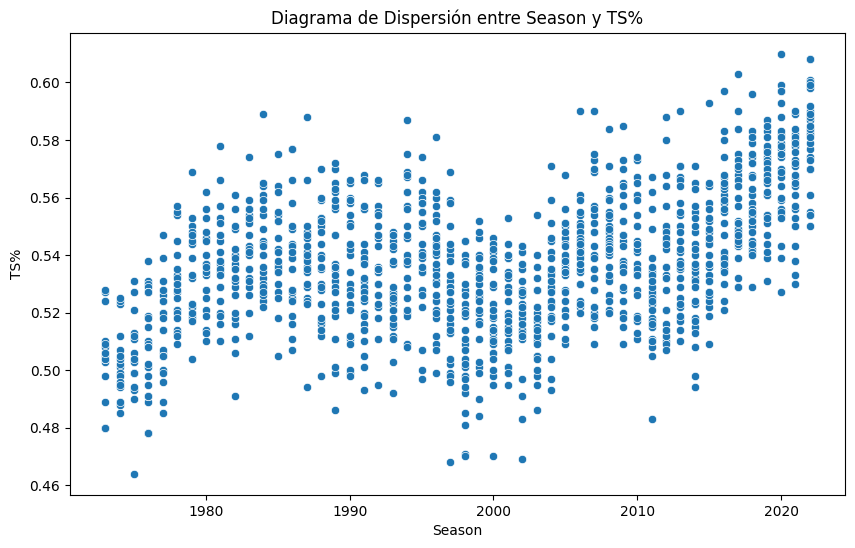

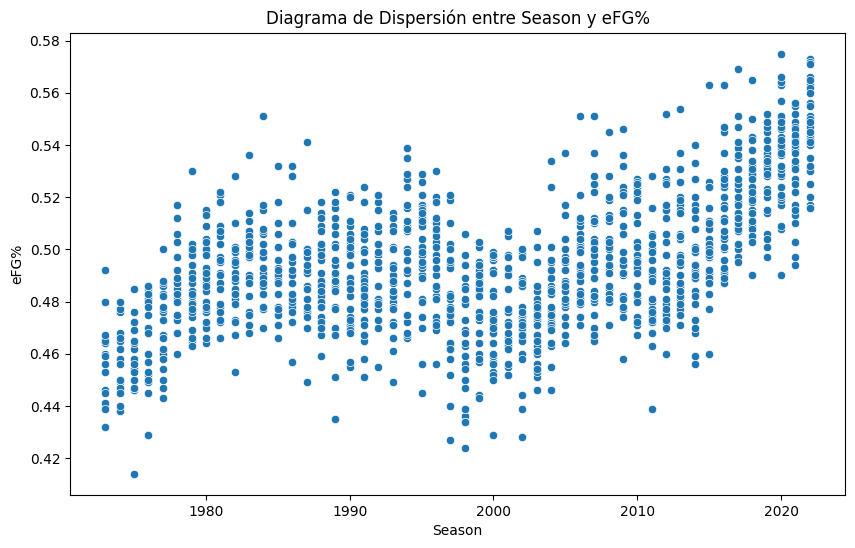

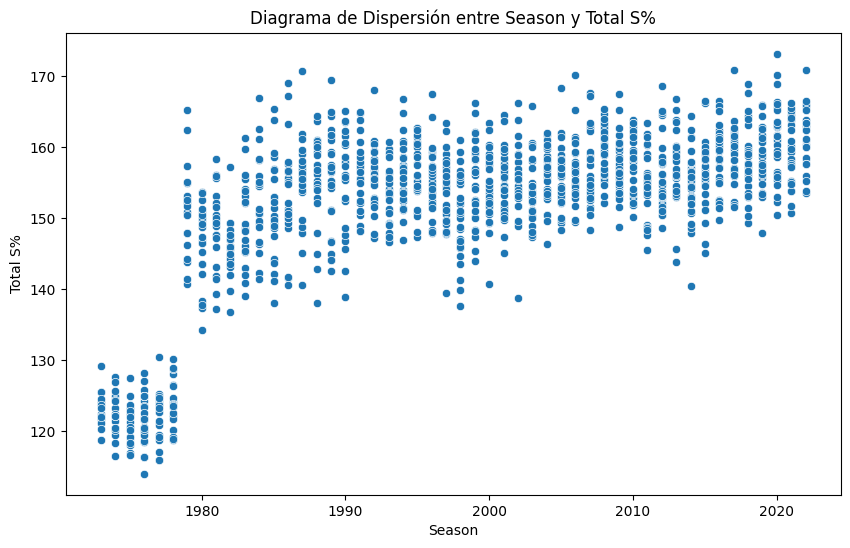

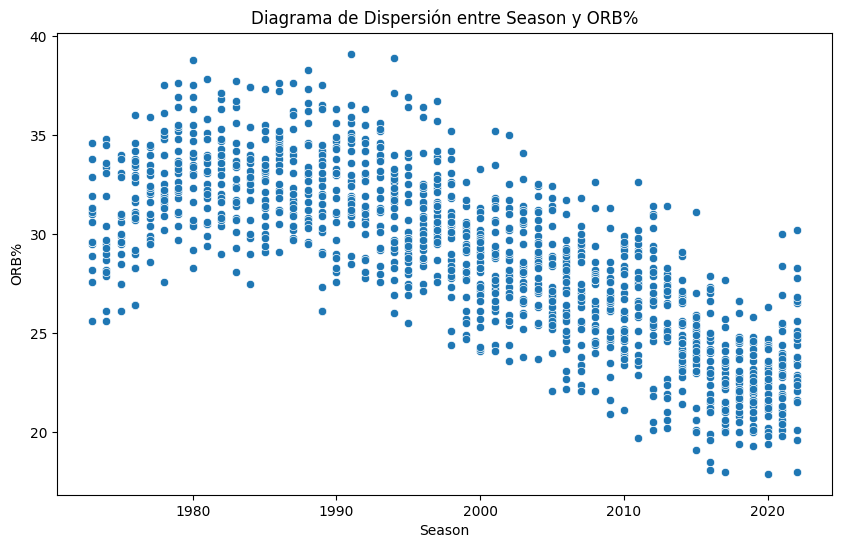

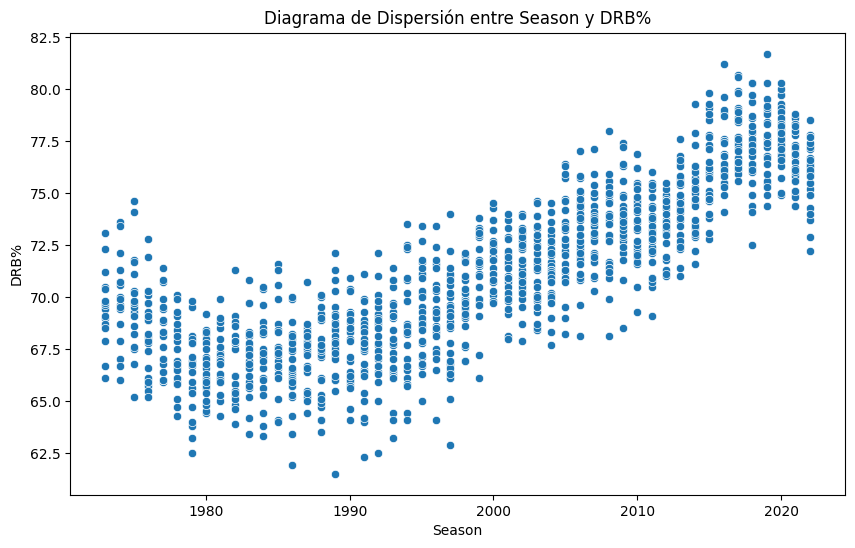

...

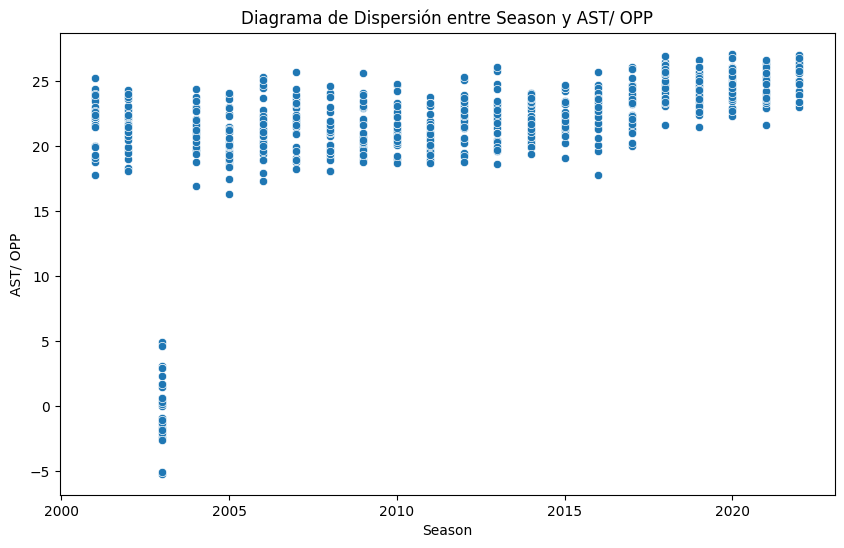

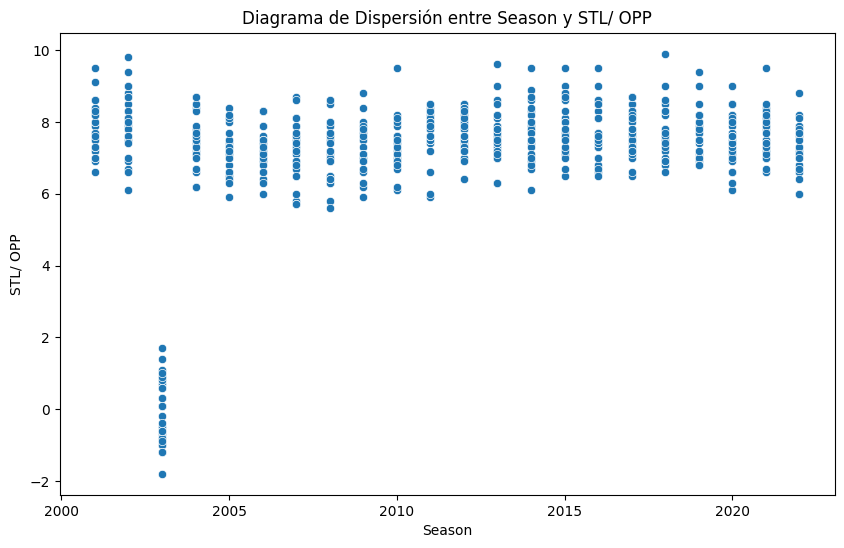

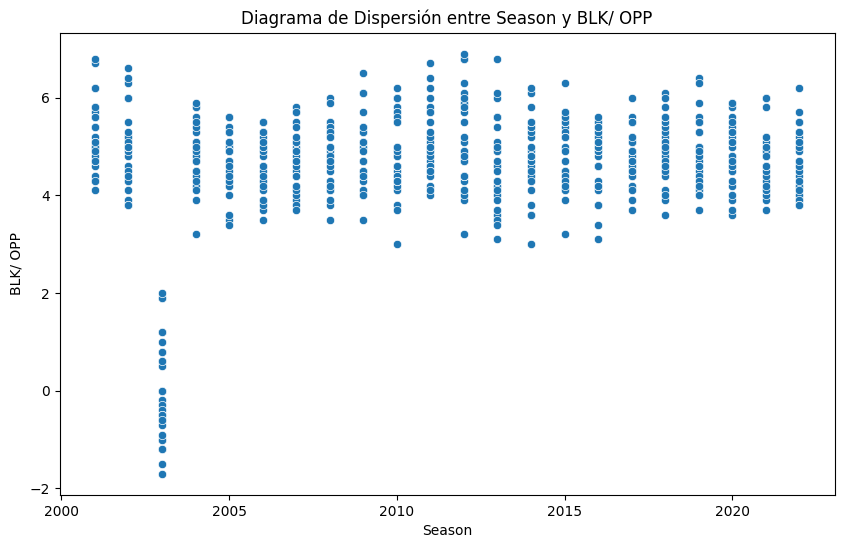

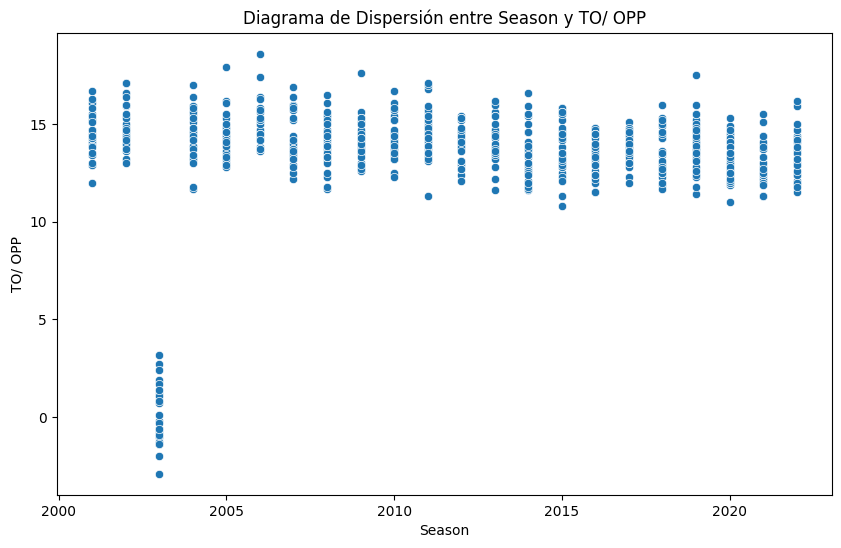

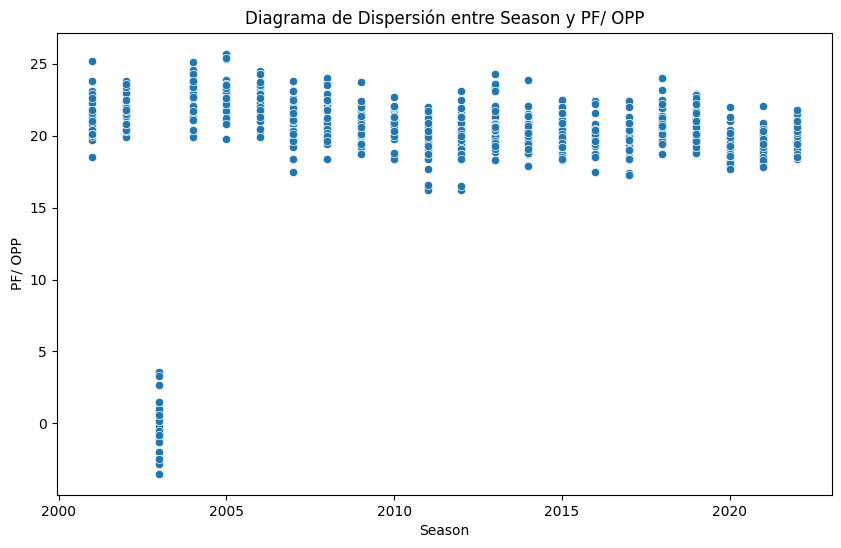

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Leer el archivo CSV
df = pd.read_csv('CombinedDatabase.csv')

# Convertir 'Season' a un formato que pueda ser utilizado en gráficos
# Aquí asumimos que 'Season' es una cadena como '2022-2023' y tomamos el primer año
df['Season'] = df['Season'].apply(lambda x: int(x.split('-')[0]))

# Seleccionar las columnas numéricas, excluyendo 'Season' si es numérica
columnas_numericas = df.select_dtypes(include=['number']).columns.drop('Season')

# Crear un diagrama de dispersión para cada variable numérica con 'Season'
for columna in columnas_numericas:
    plt.figure(figsize=(10, 6))
    sns.scatterplot(x='Season', y=columna, data=df)
    plt.title(f"Diagrama de Dispersión entre Season y {columna}")
    plt.xlabel('Season')
    plt.ylabel(columna)
    plt.show()

# **Diagramas de cajas**

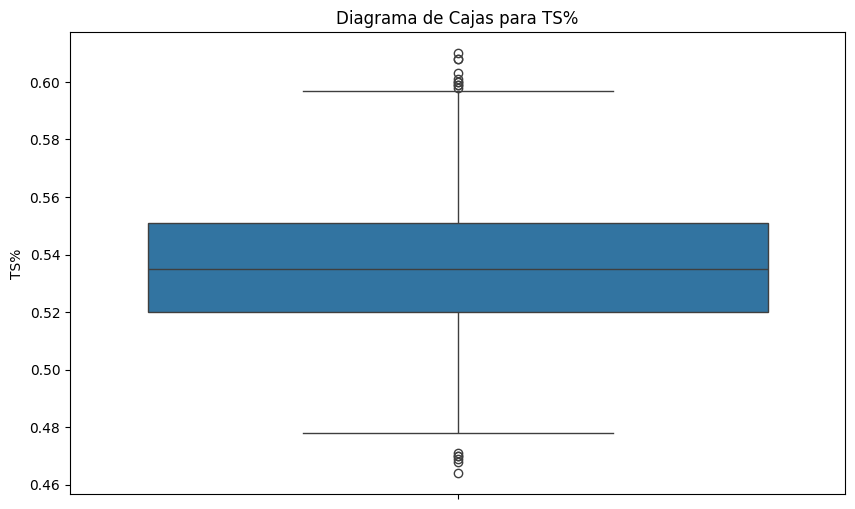

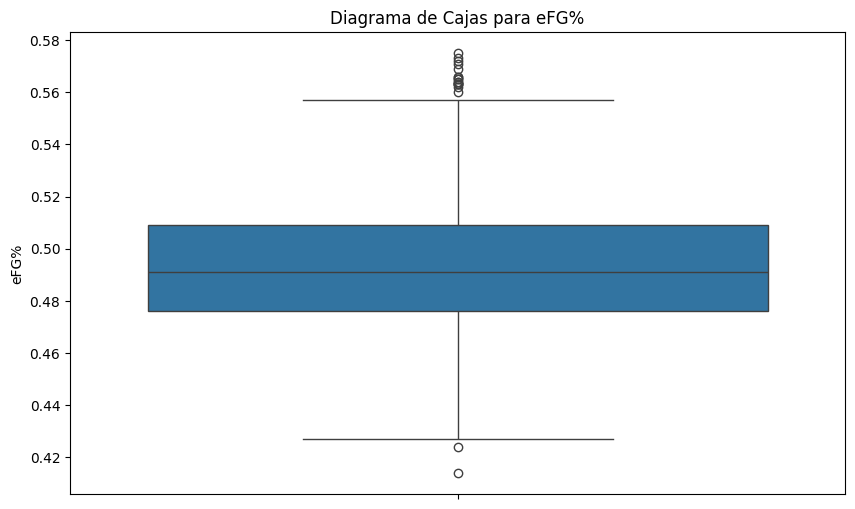

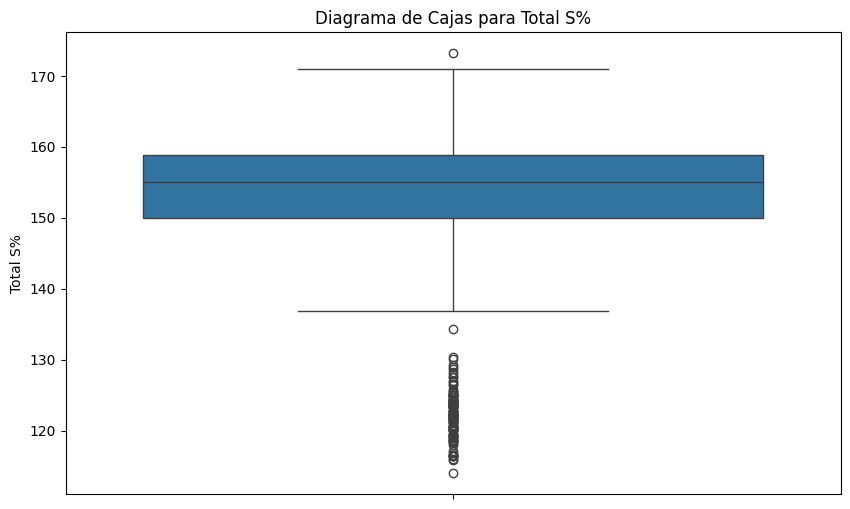

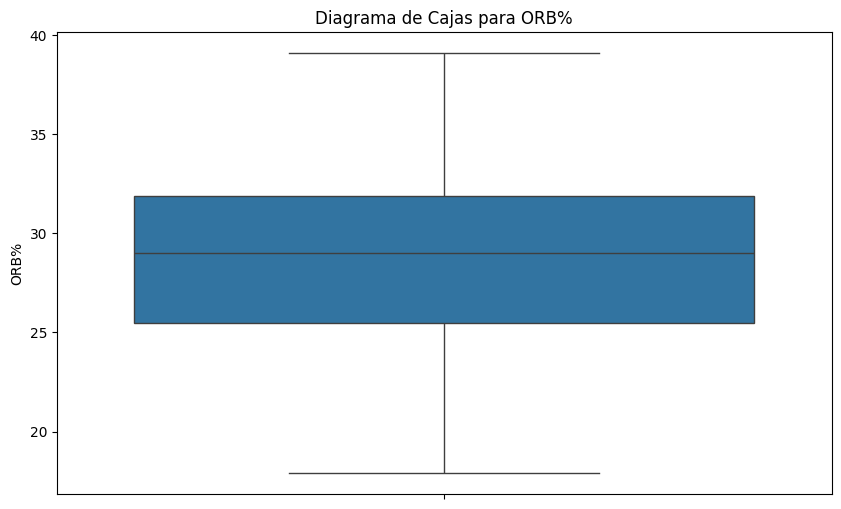

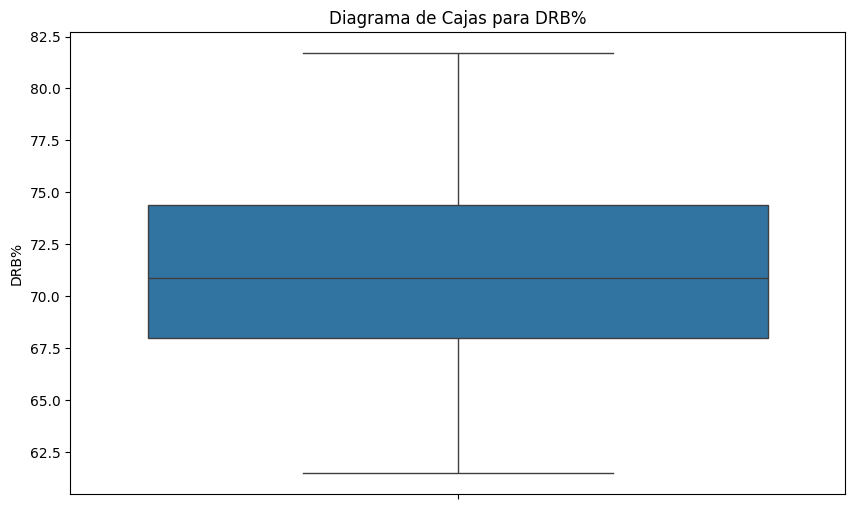

...

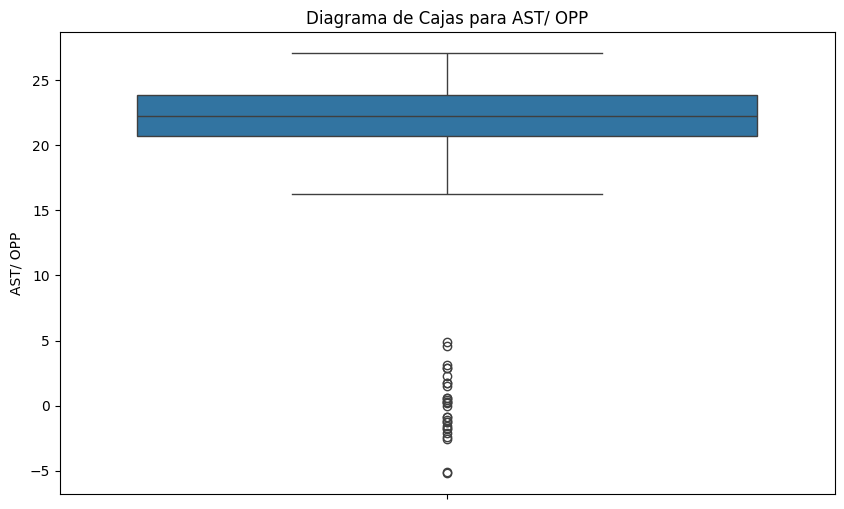

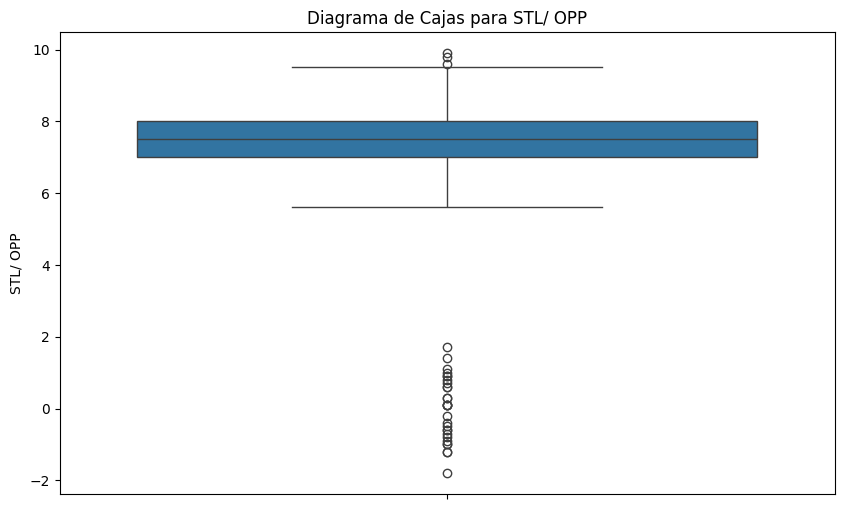

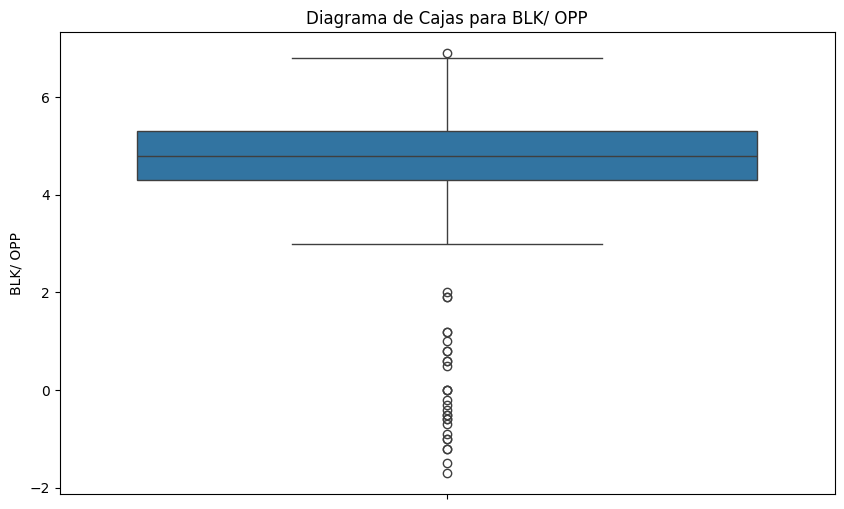

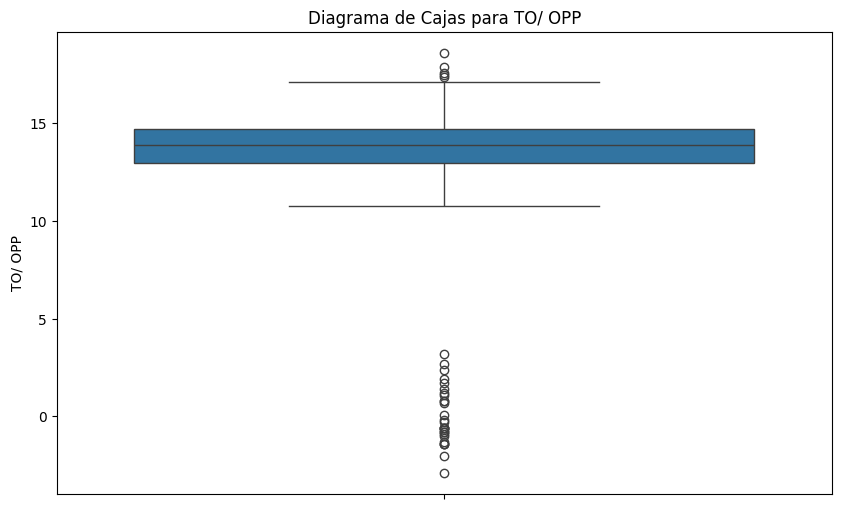

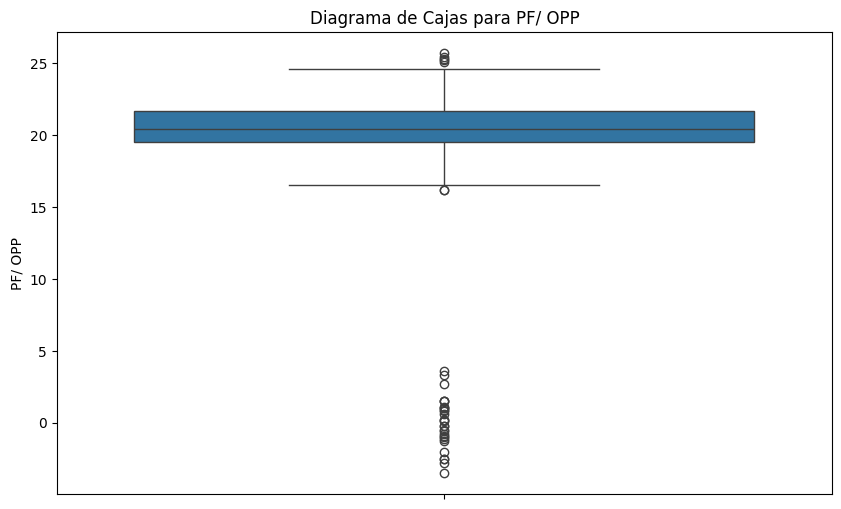

In [ ]:
# Crear un diagrama de cajas para cada variable numérica
for columna in columnas_numericas:
    plt.figure(figsize=(10, 6))
    sns.boxplot(y=df[columna])
    plt.title(f"Diagrama de Cajas para {columna}")
    plt.ylabel(columna)
    plt.show()

# **Identificar Outliers**

In [ ]:
# Leer el archivo CSV
df = pd.read_csv('CombinedDatabase.csv')

# Seleccionar las columnas numéricas
columnas_numericas = df.select_dtypes(include=['number']).columns

# Crear un DataFrame para almacenar los outliers
outliers = pd.DataFrame(columns=['Columna', 'Outliers'])

for columna in columnas_numericas:
    Q1 = df[columna].quantile(0.25)
    Q3 = df[columna].quantile(0.75)
    IQR = Q3 - Q1
    filtro = ((df[columna] < (Q1 - 1.5 * IQR)) | (df[columna] > (Q3 + 1.5 * IQR)))

    # Agregar los outliers al DataFrame
    outliers = pd.concat([outliers, pd.DataFrame({'Columna': [columna], 'Outliers': [df[columna][filtro].tolist()]})], ignore_index=True)

# Mostrar la tabla de outliers
display(outliers)

,Columna,Outliers
0,TS%,"[0.6, 0.608, 0.601, 0.608, 0.6, 0.598, 0.599, ..."
1,eFG%,"[0.566, 0.563, 0.573, 0.572, 0.571, 0.562, 0.5..."
2,Total S%,"[173.2, 134.3, 122.0, 130.1, 128.0, 128.7, 122..."
3,ORB%,[]
4,DRB%,[]
...,...,...
94,AST/ OPP,"[3.1, 1.7, 1.5, 2.3, 4.9, 0.3, 2.9, 4.6, 2.9, ..."
95,STL/ OPP,"[9.9, 9.6, 0.3, 0.1, 1.7, 0.1, 0.7, 0.9, 0.8, ..."
96,BLK/ OPP,"[6.9, 1.9, 1.9, -1.2, 2.0, -1.0, 0.6, 0.8, -0...."
97,TO/ OPP,"[17.5, 17.6, 17.4, 18.6, 17.9, -0.6, -0.8, -1...."


# **Sustituir NA por la media de las Variables**

In [ ]:
import pandas as pd
import numpy as np

# Leer el archivo CSV
df = pd.read_csv('CombinedDatabase.csv')

# Convertir explícitamente columnas a numérico, donde sea aplicable
# Esto es para evitar intentar operaciones numéricas en columnas de texto
columnas_numericas = ['3P%', '3PM', '3PA', 'TS%', 'eFG%', 'PPG', 'FGA', 'FTA', 'FGM', 'TRB%', 'AST%', 'STL%', 'BLK%', 'Poss']
for columna in columnas_numericas:
    df[columna] = pd.to_numeric(df[columna], errors='coerce')

# Sustituir NA en 3P%, 3PM, 3PA por 0
df[['3P%', '3PM', '3PA']] = df[['3P%', '3PM', '3PA']].fillna(0)


# Para las demás columnas numéricas, sustituir 'NA' por la media de la variable
for columna in df.select_dtypes(include=['number']).columns.drop(['3P%', '3PM','3PA', 'TS%', 'eFG%']):
    df[columna].fillna(df[columna].mean(), inplace=True)

# Calcular TS% donde sea NA utilizando la fórmula proporcionada
# Asegúrate de que las operaciones solo se realicen donde los datos necesarios estén disponibles
condicion_ts = df['TS%'].isna() & df['FGA'].notna() & df['FTA'].notna() & df['PPG'].notna()
df.loc[condicion_ts, 'TS%'] = df['PPG'] / (2*(df['FGA'] + 0.44 * df['FTA']))

# Calcular eFG% donde sea NA utilizando la fórmula proporcionada
condicion_efg = df['eFG%'].isna() & df['FGM'].notna() & df['3PM'].notna() & df['FGA'].notna()
df.loc[condicion_efg, 'eFG%'] = (df['FGM'] + 0.5 * df['3PM']) / df['FGA']

# Sustituir 0.0 por la media en variables específicas, excluyendo los 0.0
variables_con_cero = ['TRB%', 'AST%', 'STL%', 'BLK%', 'Poss']
for columna in variables_con_cero:
    media_sin_cero = df[df[columna] != 0][columna].mean()
    df.loc[(df[columna] == 0) & (df[columna].notna()), columna] = media_sin_cero

# Guardar el DataFrame modificado de nuevo a CSV
df.to_csv('Final_BBDD.csv', index=False)




display(df)


,Team,TS%,eFG%,Total S%,ORB%,DRB%,TRB%,AST%,TOV%_x,STL%,...,FTA/ OPP,FT%/ OPP,OR/ OPP,DR/ OPP,REB/ OPP,AST/ OPP,STL/ OPP,BLK/ OPP,TO/ OPP,PF/ OPP
0,Boston,0.600000,0.566000,166.400000,22.10000,78.500000,50.70000,63.200000,12.00000,6.30000,...,21.100000,76.900000,9.700000,34.300000,44.000000,23.100000,6.600000,3.900000,12.000000,19.100000
1,Cleveland,0.590000,0.556000,163.500000,23.60000,76.300000,49.90000,60.000000,12.30000,7.40000,...,22.400000,78.200000,9.800000,31.500000,41.200000,23.000000,7.000000,4.400000,14.700000,20.400000
2,Philadelphia,0.608000,0.563000,170.900000,21.60000,77.200000,49.90000,61.600000,12.60000,7.90000,...,23.700000,78.100000,9.500000,31.600000,41.200000,24.200000,6.600000,4.600000,13.500000,19.600000
3,Memphis,0.570000,0.540000,155.900000,26.50000,75.900000,51.20000,59.600000,11.70000,8.20000,...,23.500000,78.700000,11.000000,33.400000,44.400000,26.400000,6.800000,5.200000,14.400000,20.000000
4,Milwaukee,0.583000,0.555000,158.300000,25.00000,77.800000,52.40000,60.400000,12.70000,6.30000,...,21.000000,77.600000,10.700000,33.500000,44.200000,23.900000,7.000000,3.900000,11.500000,19.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1633,Toronto,0.314459,0.267725,152.309044,28.73573,71.229726,40.29103,48.021053,14.01238,6.70682,...,22.661492,72.798478,10.387367,30.501979,40.890411,21.447032,7.222527,4.643683,13.398478,19.804414
1634,NewYork,0.329564,0.278539,152.309044,28.73573,71.229726,40.29103,48.021053,14.01238,6.70682,...,22.661492,72.798478,10.387367,30.501979,40.890411,21.447032,7.222527,4.643683,13.398478,19.804414
1635,Detroit,0.292093,0.246407,152.309044,28.73573,71.229726,40.29103,48.021053,14.01238,6.70682,...,22.661492,72.798478,10.387367,30.501979,40.890411,21.447032,7.222527,4.643683,13.398478,19.804414
1636,Pittsburgh,0.326421,0.270859,152.309044,28.73573,71.229726,40.29103,48.021053,14.01238,6.70682,...,22.661492,72.798478,10.387367,30.501979,40.890411,21.447032,7.222527,4.643683,13.398478,19.804414


,Team,TS%,eFG%,Total S%,ORB%,DRB%,TRB%,AST%,TOV%_x,STL%,...,FTA/ OPP,FT%/ OPP,OR/ OPP,DR/ OPP,REB/ OPP,AST/ OPP,STL/ OPP,BLK/ OPP,TO/ OPP,PF/ OPP
0,Boston,0.600000,0.566000,166.400000,22.10000,78.500000,50.70000,63.200000,12.00000,6.30000,...,21.100000,76.900000,9.700000,34.300000,44.000000,23.100000,6.600000,3.900000,12.000000,19.100000
1,Cleveland,0.590000,0.556000,163.500000,23.60000,76.300000,49.90000,60.000000,12.30000,7.40000,...,22.400000,78.200000,9.800000,31.500000,41.200000,23.000000,7.000000,4.400000,14.700000,20.400000
2,Philadelphia,0.608000,0.563000,170.900000,21.60000,77.200000,49.90000,61.600000,12.60000,7.90000,...,23.700000,78.100000,9.500000,31.600000,41.200000,24.200000,6.600000,4.600000,13.500000,19.600000
3,Memphis,0.570000,0.540000,155.900000,26.50000,75.900000,51.20000,59.600000,11.70000,8.20000,...,23.500000,78.700000,11.000000,33.400000,44.400000,26.400000,6.800000,5.200000,14.400000,20.000000
4,Milwaukee,0.583000,0.555000,158.300000,25.00000,77.800000,52.40000,60.400000,12.70000,6.30000,...,21.000000,77.600000,10.700000,33.500000,44.200000,23.900000,7.000000,3.900000,11.500000,19.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1633,Toronto,0.628919,0.267725,152.309044,28.73573,71.229726,40.29103,48.021053,14.01238,6.70682,...,22.661492,72.798478,10.387367,30.501979,40.890411,21.447032,7.222527,4.643683,13.398478,19.804414
1634,NewYork,0.659128,0.278539,152.309044,28.73573,71.229726,40.29103,48.021053,14.01238,6.70682,...,22.661492,72.798478,10.387367,30.501979,40.890411,21.447032,7.222527,4.643683,13.398478,19.804414
1635,Detroit,0.584185,0.246407,152.309044,28.73573,71.229726,40.29103,48.021053,14.01238,6.70682,...,22.661492,72.798478,10.387367,30.501979,40.890411,21.447032,7.222527,4.643683,13.398478,19.804414
1636,Pittsburgh,0.652842,0.270859,152.309044,28.73573,71.229726,40.29103,48.021053,14.01238,6.70682,...,22.661492,72.798478,10.387367,30.501979,40.890411,21.447032,7.222527,4.643683,13.398478,19.804414


# **Justificación de variables**

<ipython-input-10-f953dbab2709>:26: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x='Season', y=variable, data=df, ci=None, estimator=sum, palette="coolwarm")
<ipython-input-10-f953dbab2709>:26: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Season', y=variable, data=df, ci=None, estimator=sum, palette="coolwarm")


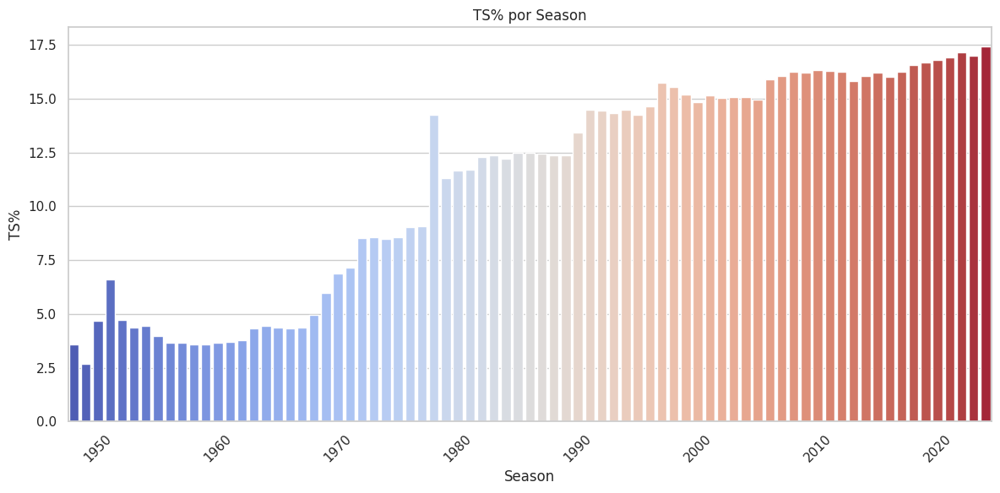

<ipython-input-10-f953dbab2709>:26: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x='Season', y=variable, data=df, ci=None, estimator=sum, palette="coolwarm")
<ipython-input-10-f953dbab2709>:26: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Season', y=variable, data=df, ci=None, estimator=sum, palette="coolwarm")


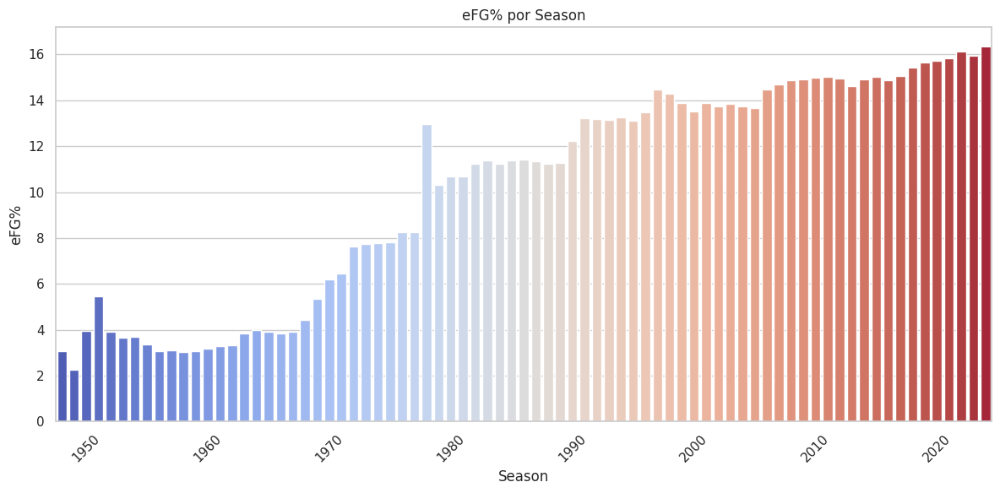

<ipython-input-10-f953dbab2709>:26: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x='Season', y=variable, data=df, ci=None, estimator=sum, palette="coolwarm")
<ipython-input-10-f953dbab2709>:26: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Season', y=variable, data=df, ci=None, estimator=sum, palette="coolwarm")


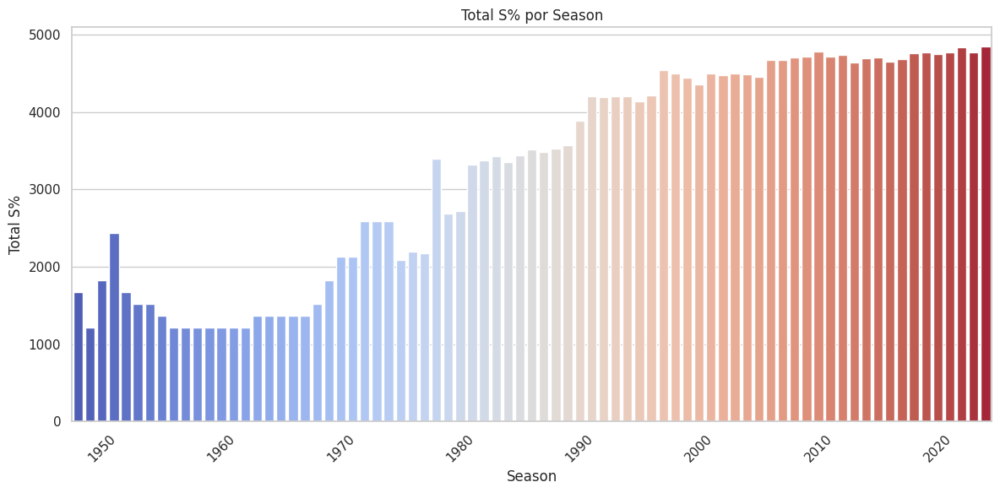

<ipython-input-10-f953dbab2709>:26: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x='Season', y=variable, data=df, ci=None, estimator=sum, palette="coolwarm")
<ipython-input-10-f953dbab2709>:26: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Season', y=variable, data=df, ci=None, estimator=sum, palette="coolwarm")


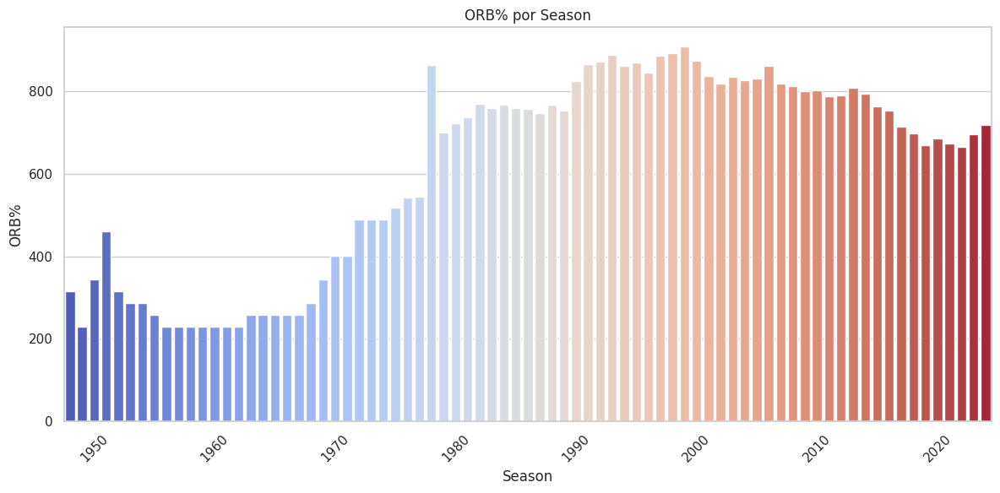

<ipython-input-10-f953dbab2709>:26: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x='Season', y=variable, data=df, ci=None, estimator=sum, palette="coolwarm")
<ipython-input-10-f953dbab2709>:26: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Season', y=variable, data=df, ci=None, estimator=sum, palette="coolwarm")


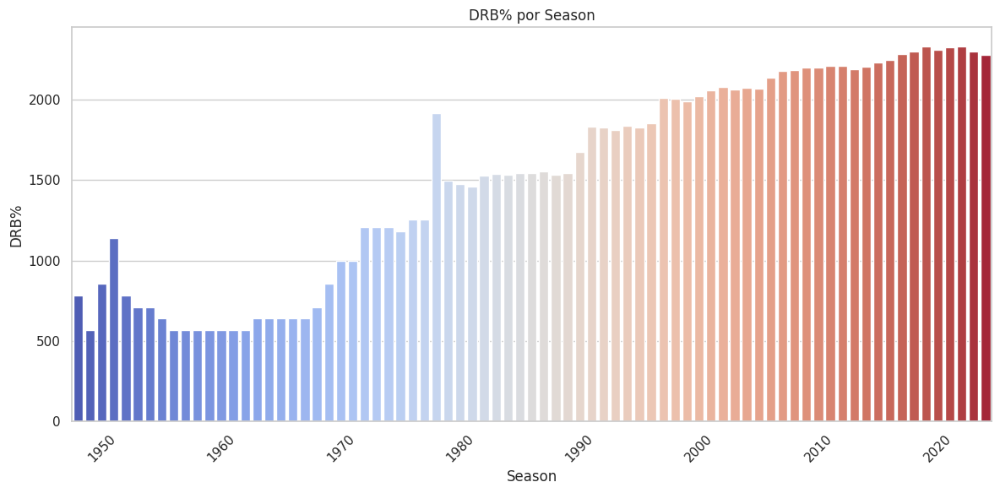

<ipython-input-10-f953dbab2709>:26: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x='Season', y=variable, data=df, ci=None, estimator=sum, palette="coolwarm")
<ipython-input-10-f953dbab2709>:26: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Season', y=variable, data=df, ci=None, estimator=sum, palette="coolwarm")


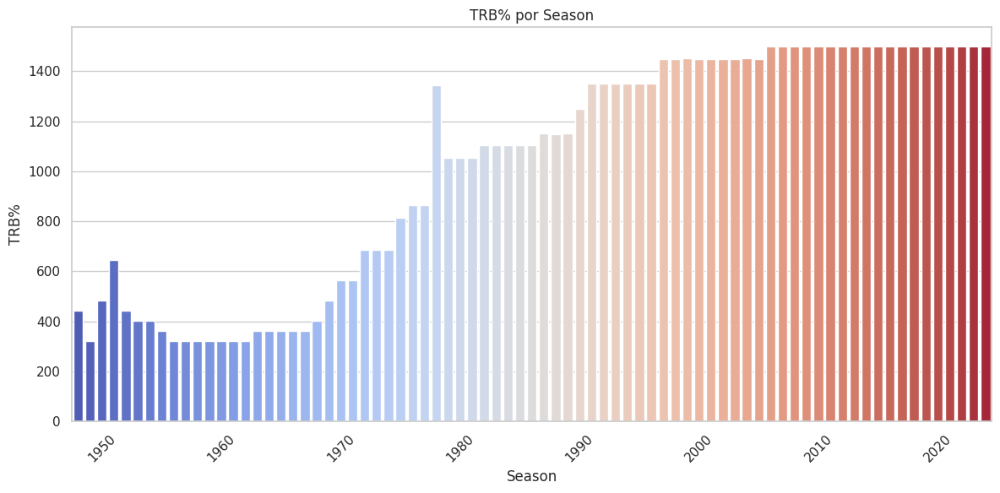

<ipython-input-10-f953dbab2709>:26: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x='Season', y=variable, data=df, ci=None, estimator=sum, palette="coolwarm")
<ipython-input-10-f953dbab2709>:26: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Season', y=variable, data=df, ci=None, estimator=sum, palette="coolwarm")


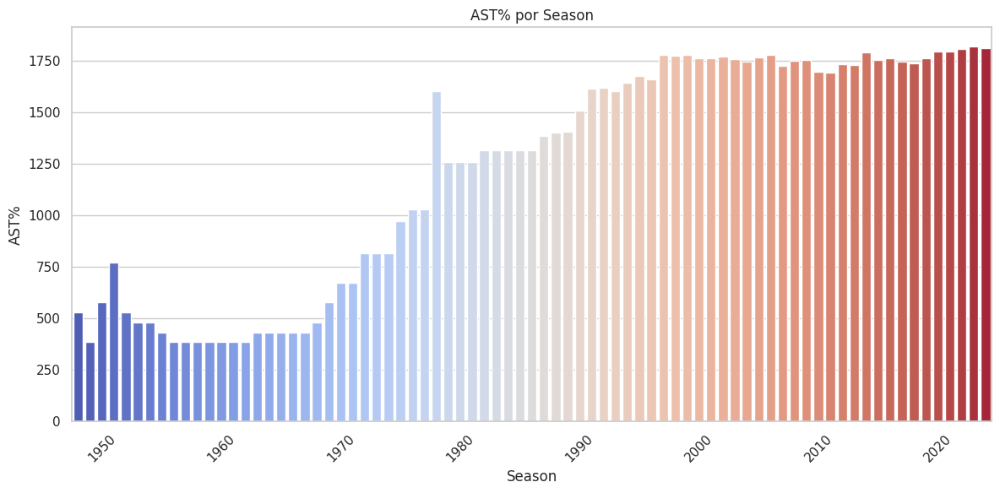

<ipython-input-10-f953dbab2709>:26: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x='Season', y=variable, data=df, ci=None, estimator=sum, palette="coolwarm")
<ipython-input-10-f953dbab2709>:26: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Season', y=variable, data=df, ci=None, estimator=sum, palette="coolwarm")


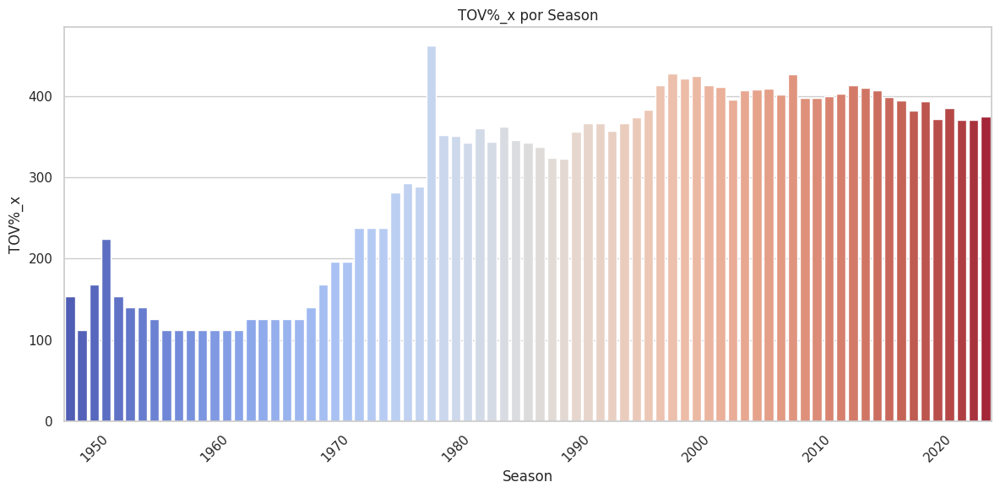

<ipython-input-10-f953dbab2709>:26: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x='Season', y=variable, data=df, ci=None, estimator=sum, palette="coolwarm")
<ipython-input-10-f953dbab2709>:26: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Season', y=variable, data=df, ci=None, estimator=sum, palette="coolwarm")


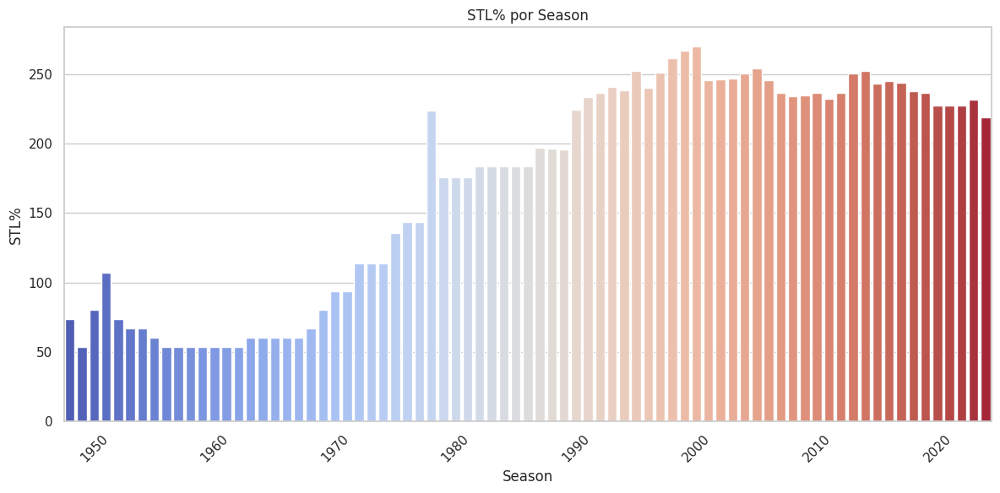

<ipython-input-10-f953dbab2709>:26: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x='Season', y=variable, data=df, ci=None, estimator=sum, palette="coolwarm")
<ipython-input-10-f953dbab2709>:26: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Season', y=variable, data=df, ci=None, estimator=sum, palette="coolwarm")


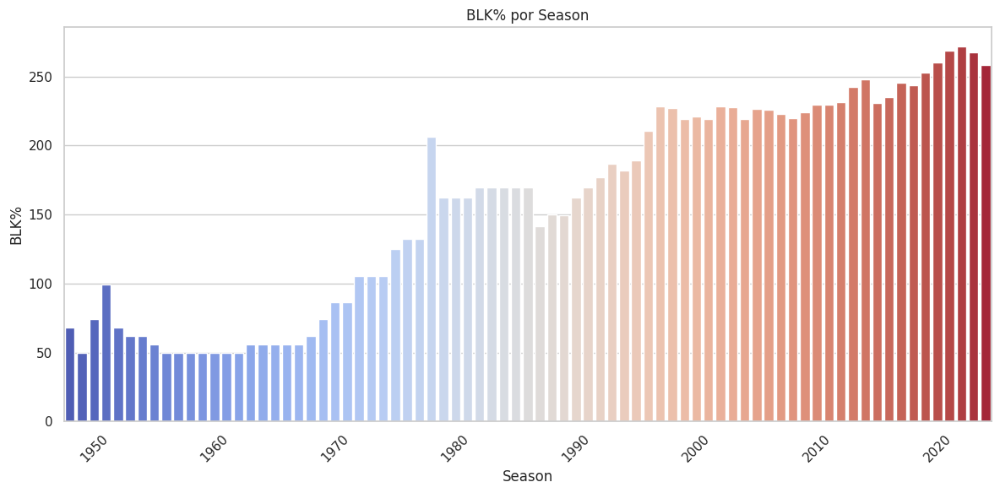

<ipython-input-10-f953dbab2709>:26: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x='Season', y=variable, data=df, ci=None, estimator=sum, palette="coolwarm")
<ipython-input-10-f953dbab2709>:26: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Season', y=variable, data=df, ci=None, estimator=sum, palette="coolwarm")


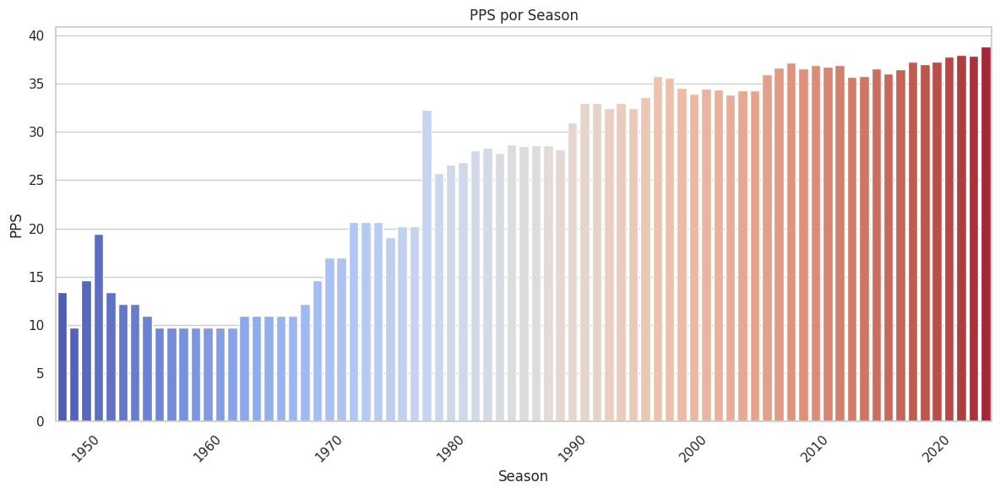

<ipython-input-10-f953dbab2709>:26: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x='Season', y=variable, data=df, ci=None, estimator=sum, palette="coolwarm")
<ipython-input-10-f953dbab2709>:26: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Season', y=variable, data=df, ci=None, estimator=sum, palette="coolwarm")


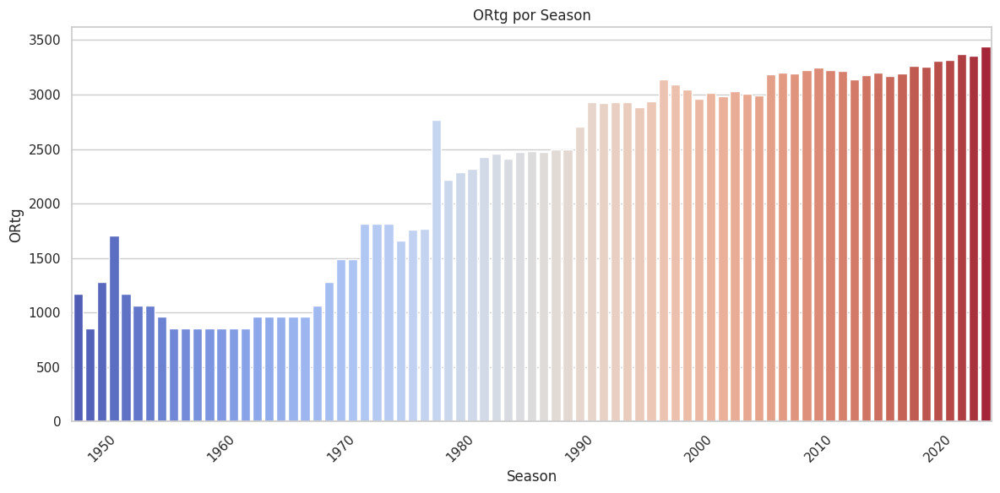

<ipython-input-10-f953dbab2709>:26: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x='Season', y=variable, data=df, ci=None, estimator=sum, palette="coolwarm")
<ipython-input-10-f953dbab2709>:26: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Season', y=variable, data=df, ci=None, estimator=sum, palette="coolwarm")


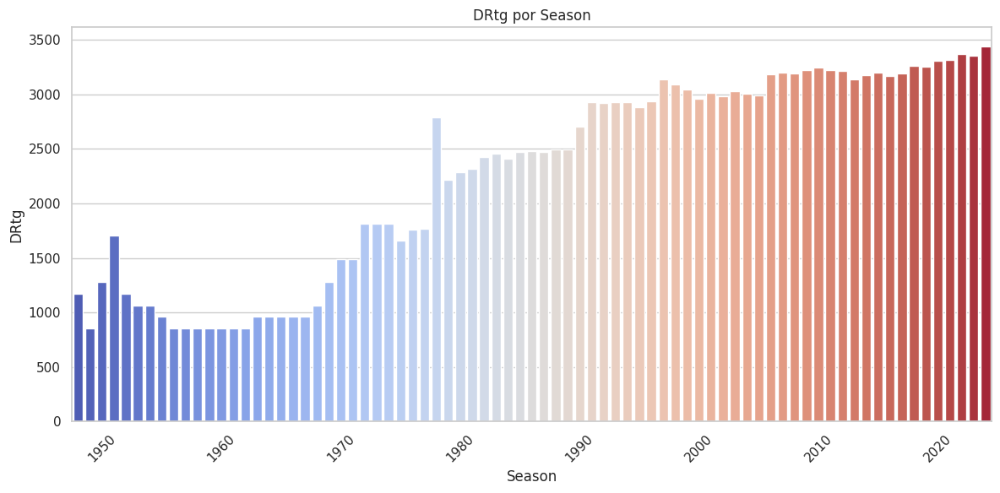

<ipython-input-10-f953dbab2709>:26: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x='Season', y=variable, data=df, ci=None, estimator=sum, palette="coolwarm")
<ipython-input-10-f953dbab2709>:26: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Season', y=variable, data=df, ci=None, estimator=sum, palette="coolwarm")


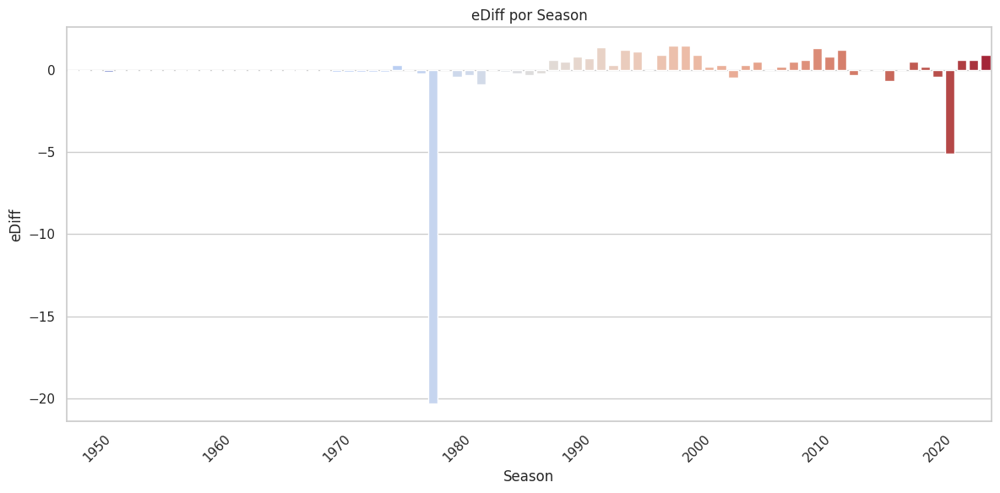

<ipython-input-10-f953dbab2709>:26: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x='Season', y=variable, data=df, ci=None, estimator=sum, palette="coolwarm")
<ipython-input-10-f953dbab2709>:26: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Season', y=variable, data=df, ci=None, estimator=sum, palette="coolwarm")


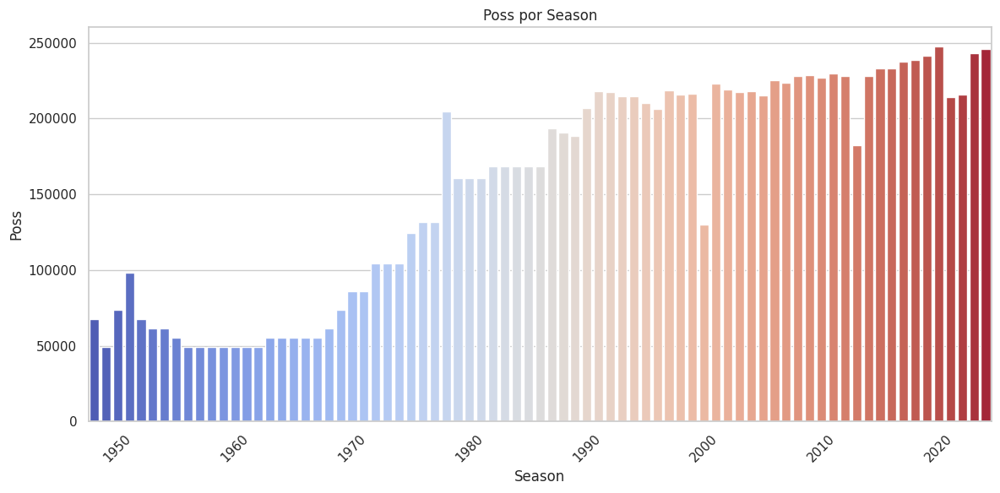

<ipython-input-10-f953dbab2709>:26: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x='Season', y=variable, data=df, ci=None, estimator=sum, palette="coolwarm")
<ipython-input-10-f953dbab2709>:26: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Season', y=variable, data=df, ci=None, estimator=sum, palette="coolwarm")


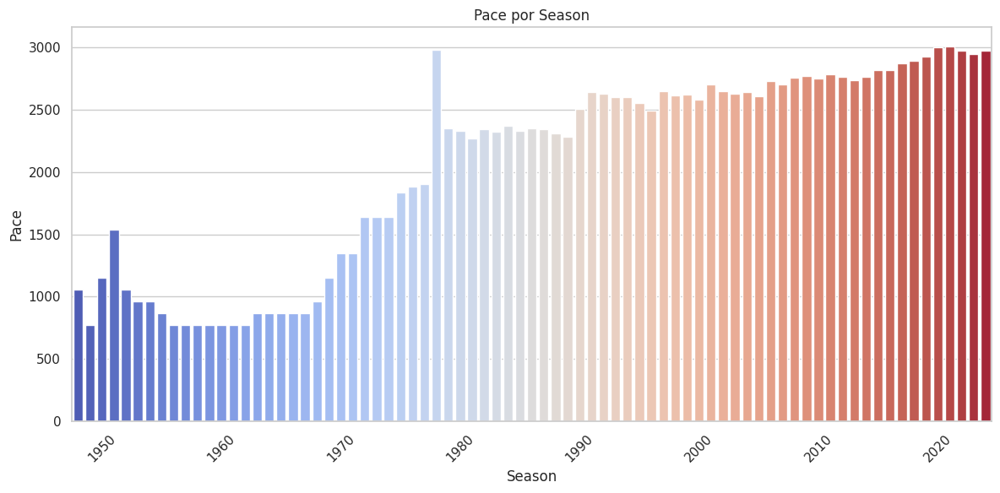

<ipython-input-10-f953dbab2709>:26: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x='Season', y=variable, data=df, ci=None, estimator=sum, palette="coolwarm")
<ipython-input-10-f953dbab2709>:26: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Season', y=variable, data=df, ci=None, estimator=sum, palette="coolwarm")


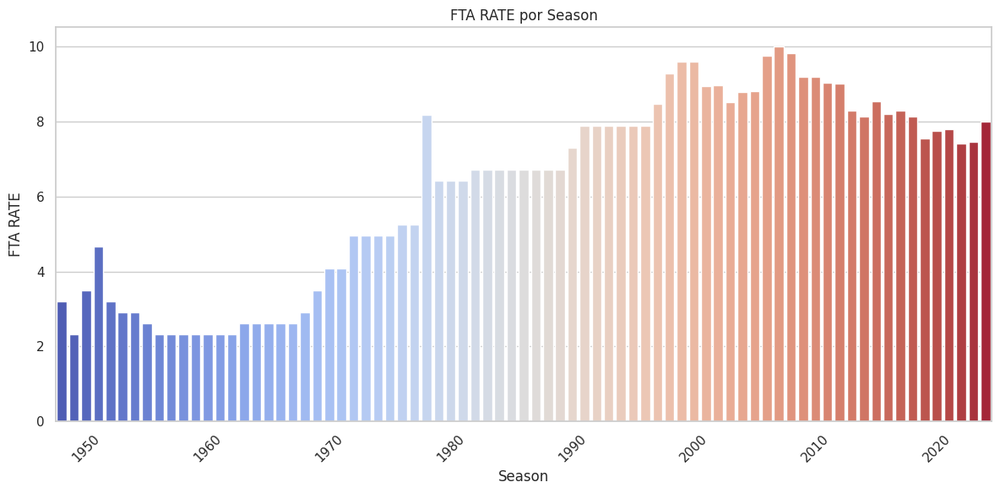

<ipython-input-10-f953dbab2709>:26: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x='Season', y=variable, data=df, ci=None, estimator=sum, palette="coolwarm")
<ipython-input-10-f953dbab2709>:26: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Season', y=variable, data=df, ci=None, estimator=sum, palette="coolwarm")


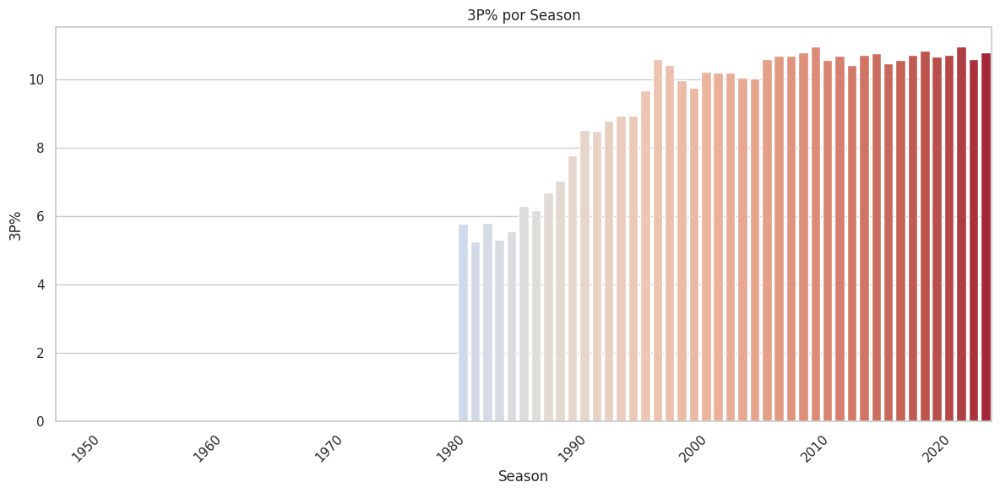

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns



# Configuración para mejorar la estética de los gráficos
sns.set(style="whitegrid")

# Leer el archivo CSV
df = pd.read_csv('Final_BBDD.csv')

# Convertir 'Season' a un formato que pueda ser utilizado en gráficos
# Aquí asumimos que 'Season' es una cadena como '2022-2023' y tomamos el primer año
df['Season'] = df['Season'].apply(lambda x: int(x.split('-')[0]))

# Seleccionar las columnas numéricas, excluyendo 'Season' si es numérica
# = ['Pace', 'ORtg', 'DRtg', 'TRB%', 'DRB%', 'ORB%', 'AST%', 'TOV%_x',  'BLK%', 'STL%', 'Ast/TO', 'FTA RATE', '3P%', 'FTM', 'FTA', 'FT%', 'FG%', 'TS%', 'eFG%', 'PPS']
variables = ['TS%', 'eFG%', 'Total S%', 'ORB%', 'DRB%', 'TRB%', 'AST%', 'TOV%_x', 'STL%', 'BLK%', 'PPS', 'ORtg', 'DRtg', 'eDiff', 'Poss', 'Pace','FTA RATE','3P%']
# Ajustar las marcas del eje x para mostrar solo décadas específicas
decades = range((df['Season'].min() // 10) * 10, (df['Season'].max() // 10) * 10 + 10, 10)

# Crear un gráfico de columnas para cada variable numérica con 'Season'
for variable in variables:
    plt.figure(figsize=(12, 6))
    sns.barplot(x='Season', y=variable, data=df, ci=None, estimator=sum, palette="coolwarm")
    plt.title(f"{variable} por Season")
    plt.xlabel('Season')
    plt.ylabel(variable)

    # Ajustar las marcas del eje x para mostrar solo las décadas
    plt.xticks(ticks=[i for i, season in enumerate(df['Season'].unique()) if season in decades], labels=[str(decade) for decade in decades if decade in df['Season'].values])

    plt.xticks(rotation=45)  # Rotar las etiquetas del eje x para mejor legibilidad
    plt.tight_layout()  # Ajusta automáticamente los parámetros de la subtrama
    plt.show()


<ipython-input-11-443aa223a248>:25: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x='Season', y=variable, data=df, ci=None, estimator=np.mean, palette="coolwarm")
<ipython-input-11-443aa223a248>:25: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Season', y=variable, data=df, ci=None, estimator=np.mean, palette="coolwarm")


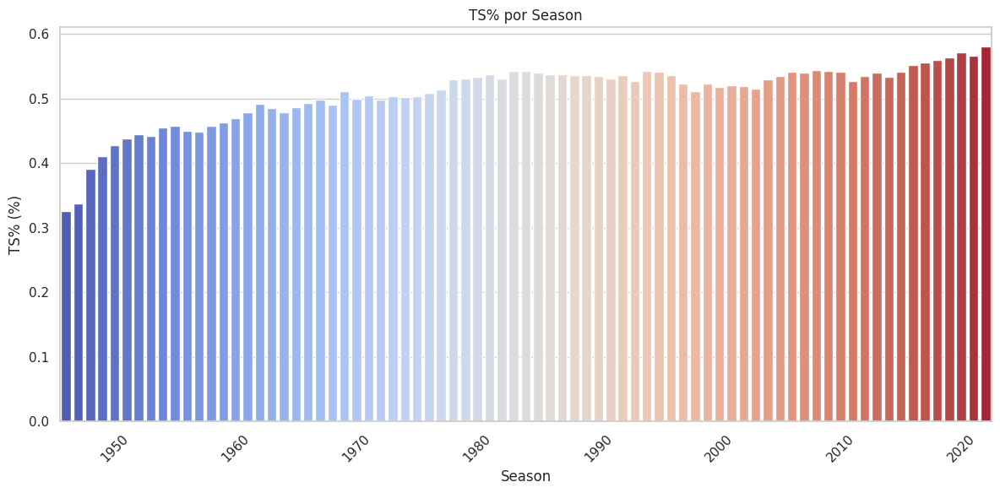

<ipython-input-11-443aa223a248>:25: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x='Season', y=variable, data=df, ci=None, estimator=np.mean, palette="coolwarm")
<ipython-input-11-443aa223a248>:25: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Season', y=variable, data=df, ci=None, estimator=np.mean, palette="coolwarm")


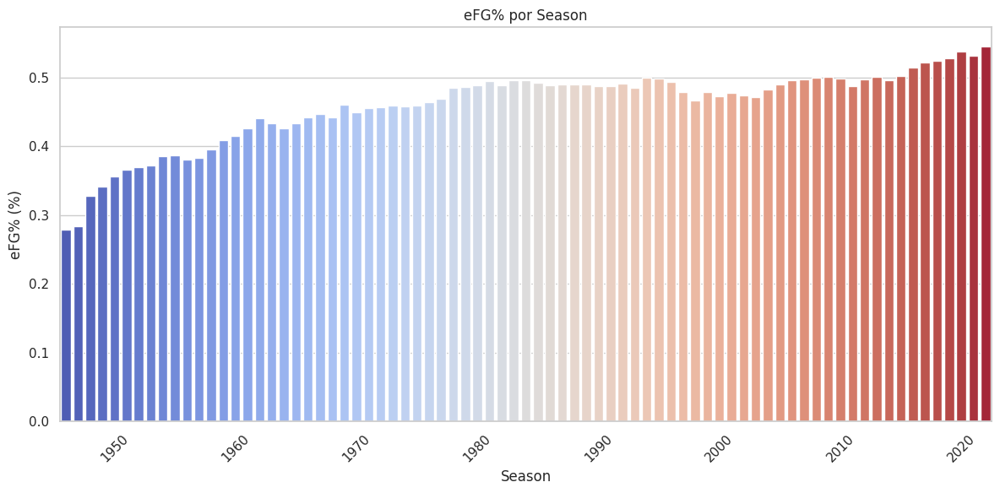

<ipython-input-11-443aa223a248>:25: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x='Season', y=variable, data=df, ci=None, estimator=np.mean, palette="coolwarm")
<ipython-input-11-443aa223a248>:25: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Season', y=variable, data=df, ci=None, estimator=np.mean, palette="coolwarm")


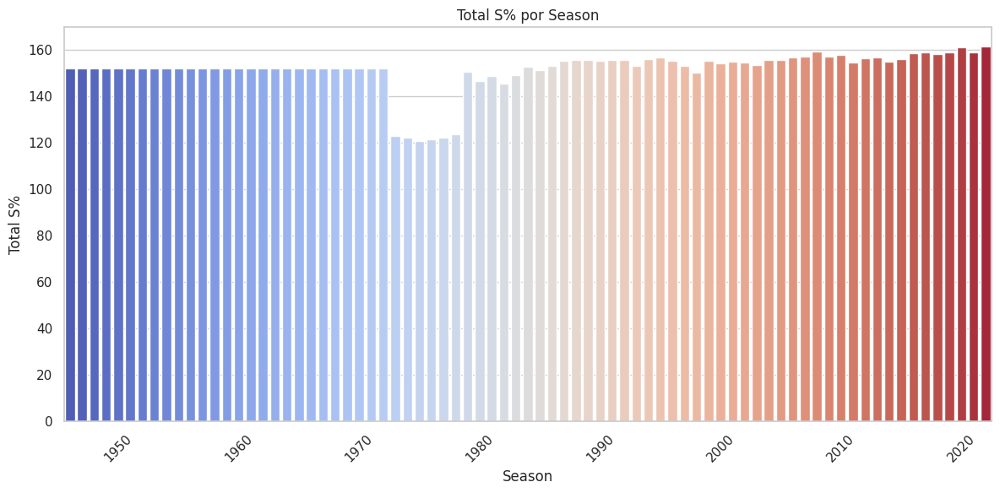

<ipython-input-11-443aa223a248>:25: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x='Season', y=variable, data=df, ci=None, estimator=np.mean, palette="coolwarm")
<ipython-input-11-443aa223a248>:25: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Season', y=variable, data=df, ci=None, estimator=np.mean, palette="coolwarm")


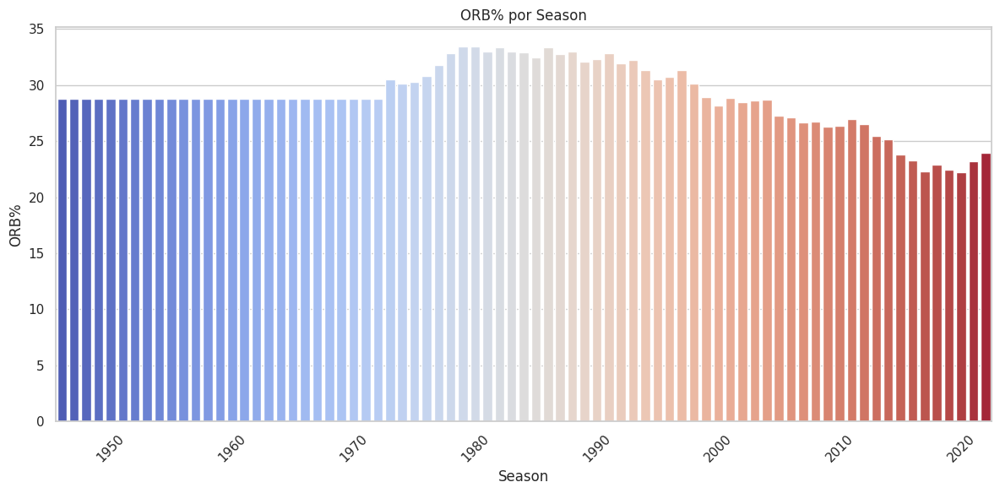

<ipython-input-11-443aa223a248>:25: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x='Season', y=variable, data=df, ci=None, estimator=np.mean, palette="coolwarm")
<ipython-input-11-443aa223a248>:25: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Season', y=variable, data=df, ci=None, estimator=np.mean, palette="coolwarm")


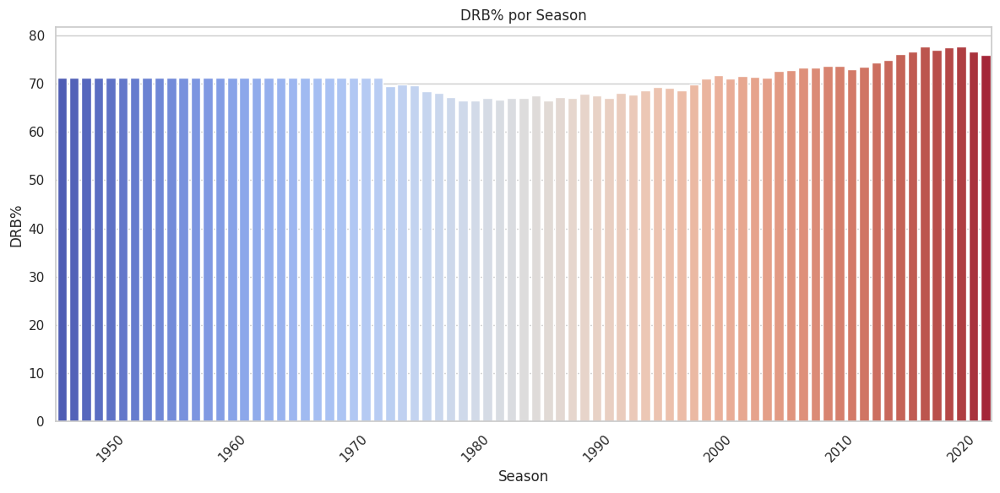

<ipython-input-11-443aa223a248>:25: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x='Season', y=variable, data=df, ci=None, estimator=np.mean, palette="coolwarm")
<ipython-input-11-443aa223a248>:25: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Season', y=variable, data=df, ci=None, estimator=np.mean, palette="coolwarm")


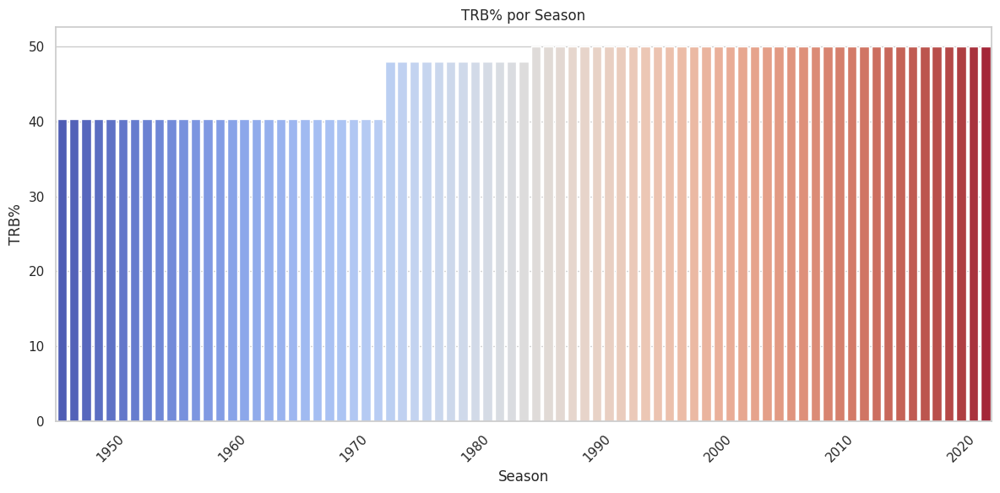

<ipython-input-11-443aa223a248>:25: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x='Season', y=variable, data=df, ci=None, estimator=np.mean, palette="coolwarm")
<ipython-input-11-443aa223a248>:25: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Season', y=variable, data=df, ci=None, estimator=np.mean, palette="coolwarm")


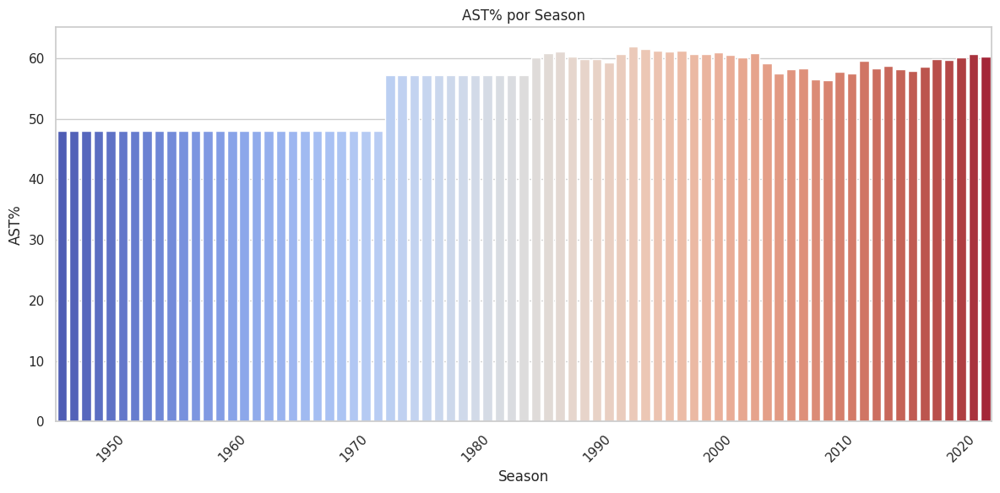

<ipython-input-11-443aa223a248>:25: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x='Season', y=variable, data=df, ci=None, estimator=np.mean, palette="coolwarm")
<ipython-input-11-443aa223a248>:25: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Season', y=variable, data=df, ci=None, estimator=np.mean, palette="coolwarm")


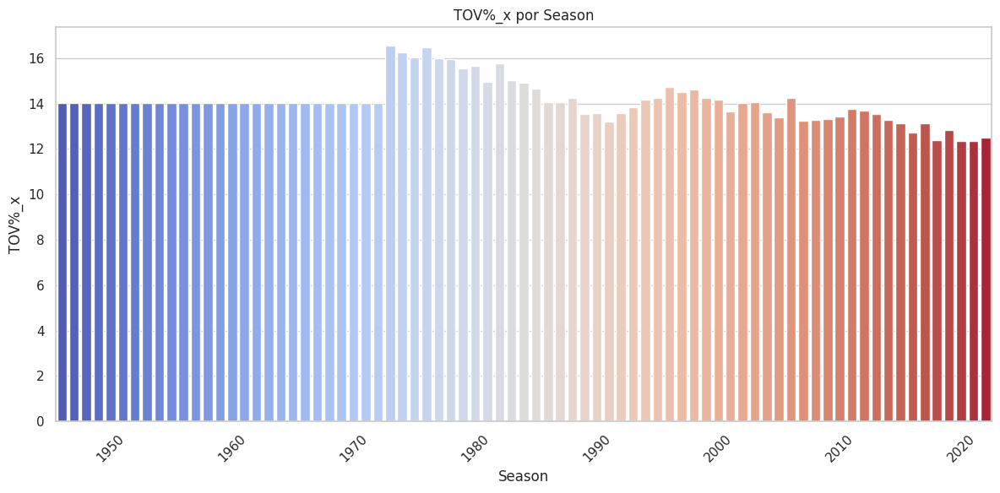

<ipython-input-11-443aa223a248>:25: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x='Season', y=variable, data=df, ci=None, estimator=np.mean, palette="coolwarm")
<ipython-input-11-443aa223a248>:25: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Season', y=variable, data=df, ci=None, estimator=np.mean, palette="coolwarm")


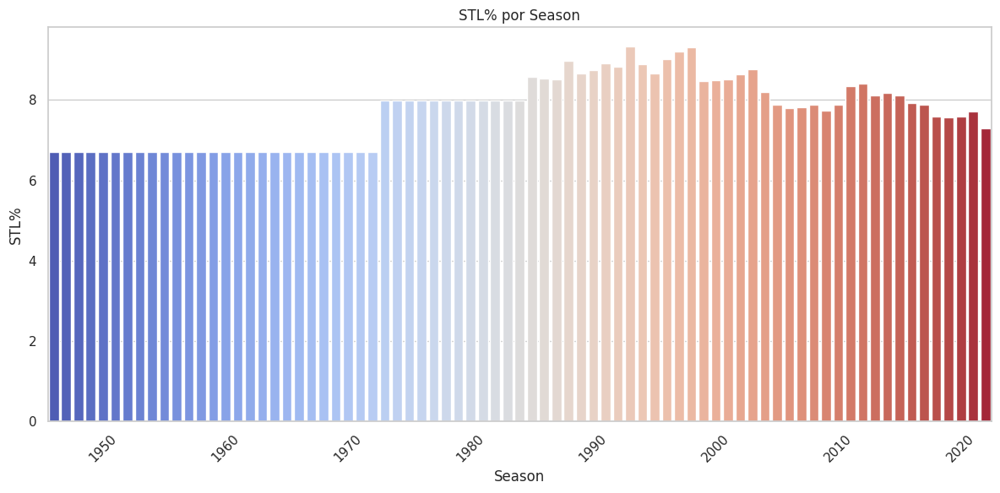

<ipython-input-11-443aa223a248>:25: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x='Season', y=variable, data=df, ci=None, estimator=np.mean, palette="coolwarm")
<ipython-input-11-443aa223a248>:25: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Season', y=variable, data=df, ci=None, estimator=np.mean, palette="coolwarm")


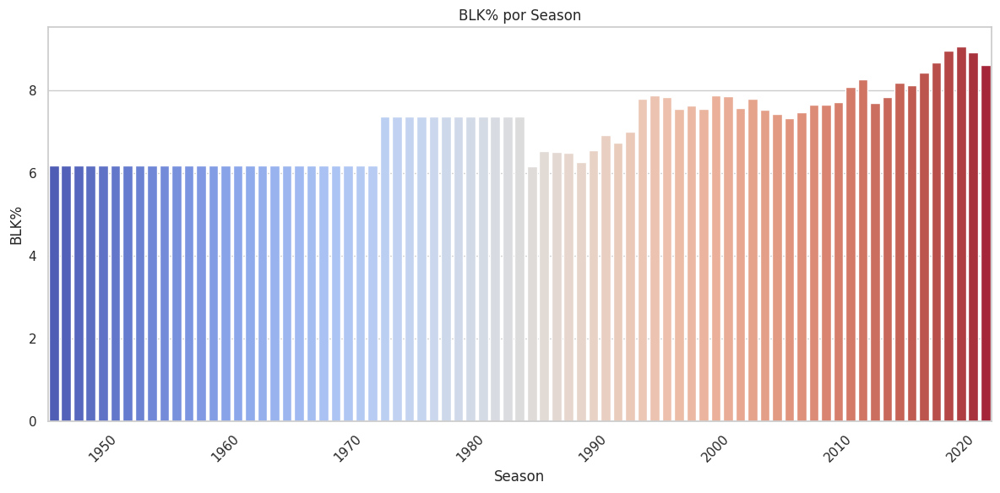

<ipython-input-11-443aa223a248>:25: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x='Season', y=variable, data=df, ci=None, estimator=np.mean, palette="coolwarm")
<ipython-input-11-443aa223a248>:25: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Season', y=variable, data=df, ci=None, estimator=np.mean, palette="coolwarm")


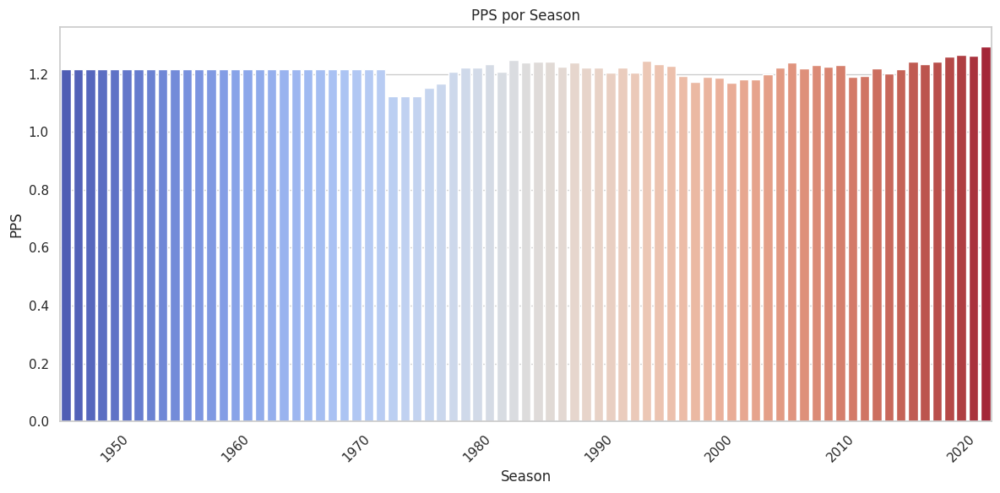

<ipython-input-11-443aa223a248>:25: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x='Season', y=variable, data=df, ci=None, estimator=np.mean, palette="coolwarm")
<ipython-input-11-443aa223a248>:25: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Season', y=variable, data=df, ci=None, estimator=np.mean, palette="coolwarm")


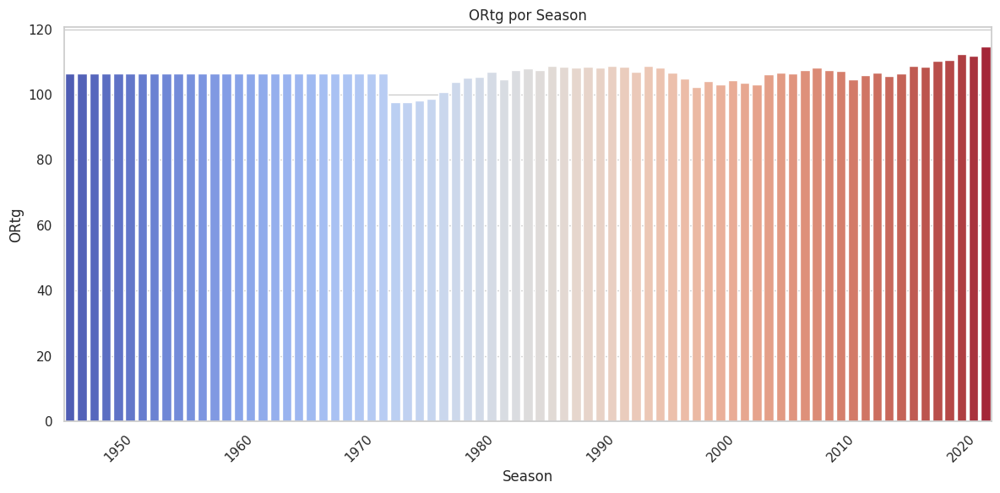

<ipython-input-11-443aa223a248>:25: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x='Season', y=variable, data=df, ci=None, estimator=np.mean, palette="coolwarm")
<ipython-input-11-443aa223a248>:25: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Season', y=variable, data=df, ci=None, estimator=np.mean, palette="coolwarm")


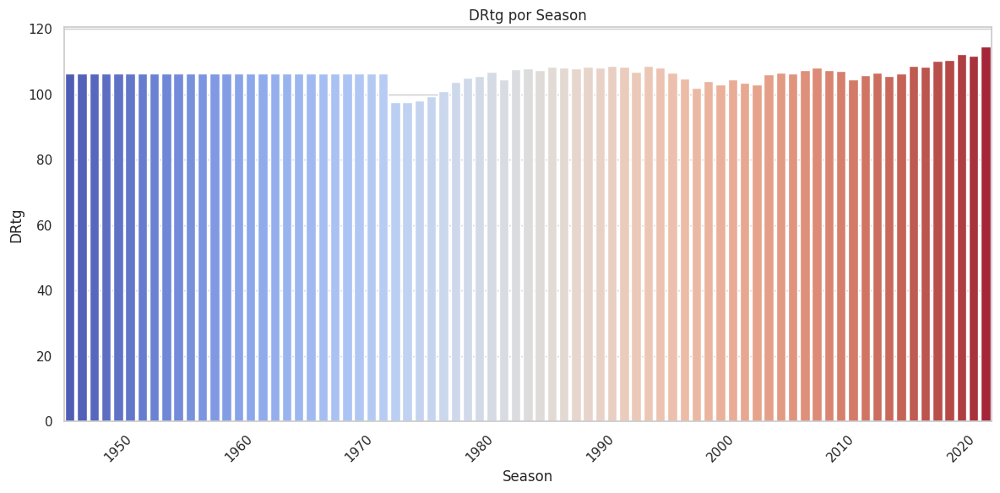

<ipython-input-11-443aa223a248>:25: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x='Season', y=variable, data=df, ci=None, estimator=np.mean, palette="coolwarm")
<ipython-input-11-443aa223a248>:25: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Season', y=variable, data=df, ci=None, estimator=np.mean, palette="coolwarm")


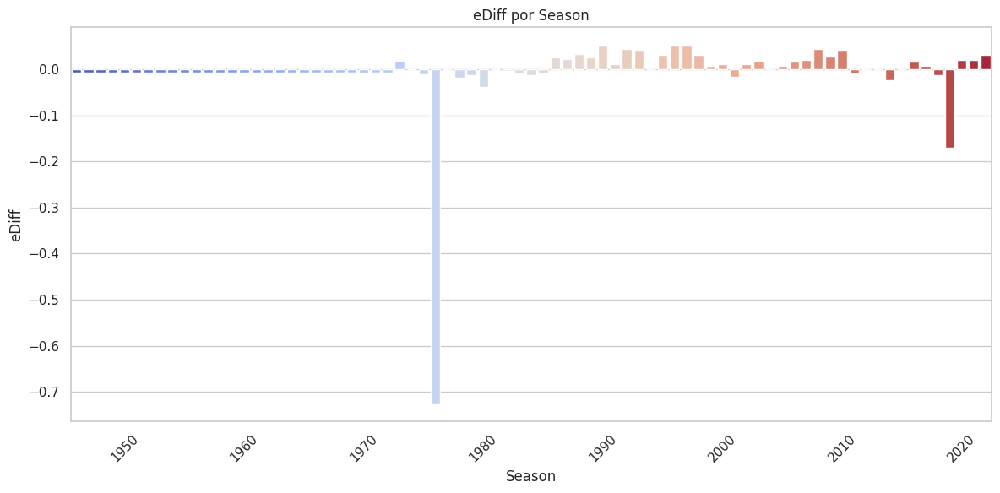

<ipython-input-11-443aa223a248>:25: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x='Season', y=variable, data=df, ci=None, estimator=np.mean, palette="coolwarm")
<ipython-input-11-443aa223a248>:25: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Season', y=variable, data=df, ci=None, estimator=np.mean, palette="coolwarm")


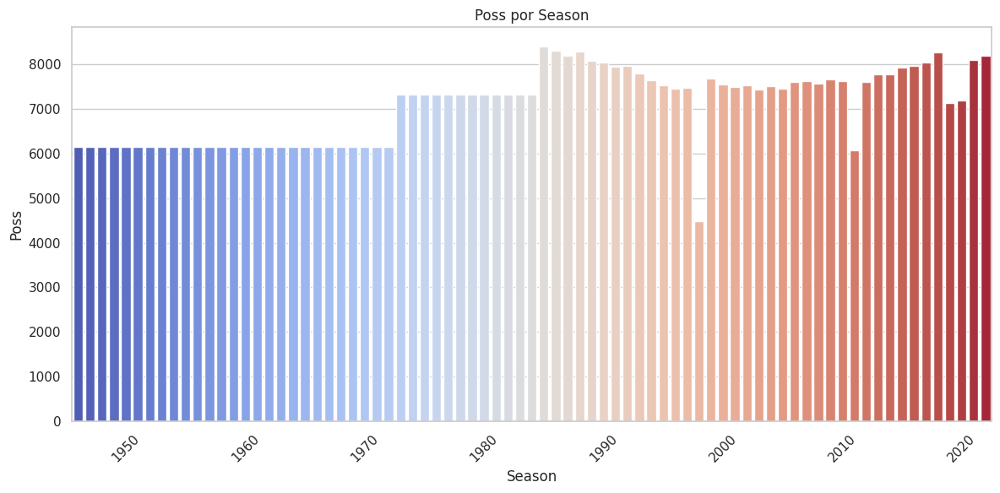

<ipython-input-11-443aa223a248>:25: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x='Season', y=variable, data=df, ci=None, estimator=np.mean, palette="coolwarm")
<ipython-input-11-443aa223a248>:25: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Season', y=variable, data=df, ci=None, estimator=np.mean, palette="coolwarm")


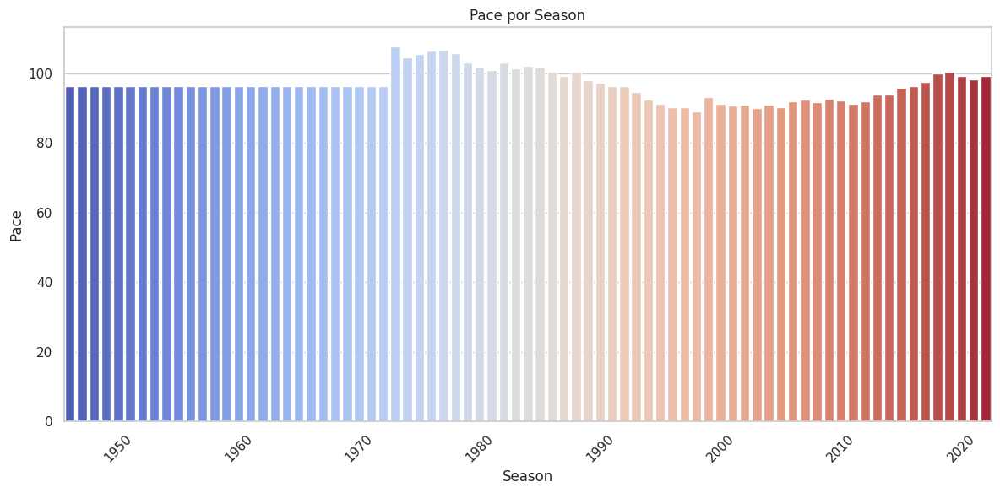

<ipython-input-11-443aa223a248>:25: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x='Season', y=variable, data=df, ci=None, estimator=np.mean, palette="coolwarm")
<ipython-input-11-443aa223a248>:25: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Season', y=variable, data=df, ci=None, estimator=np.mean, palette="coolwarm")


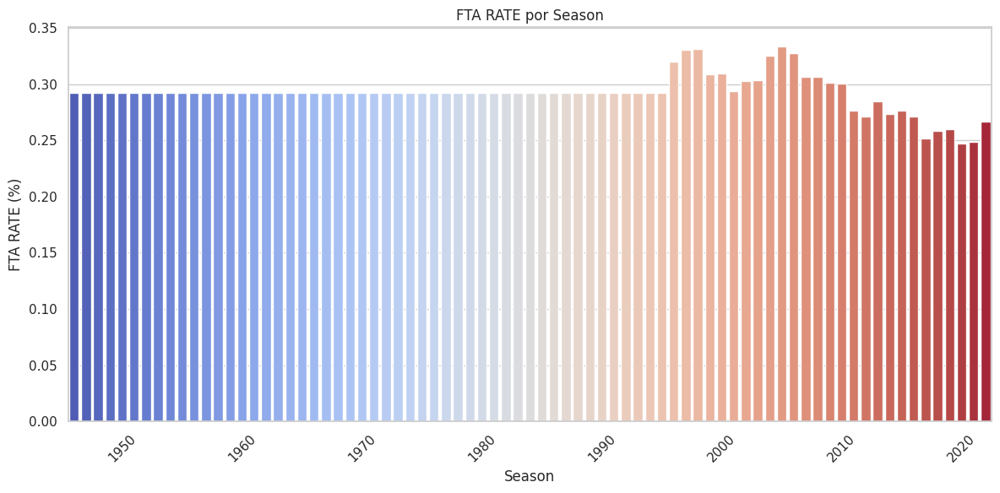

<ipython-input-11-443aa223a248>:25: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x='Season', y=variable, data=df, ci=None, estimator=np.mean, palette="coolwarm")
<ipython-input-11-443aa223a248>:25: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Season', y=variable, data=df, ci=None, estimator=np.mean, palette="coolwarm")


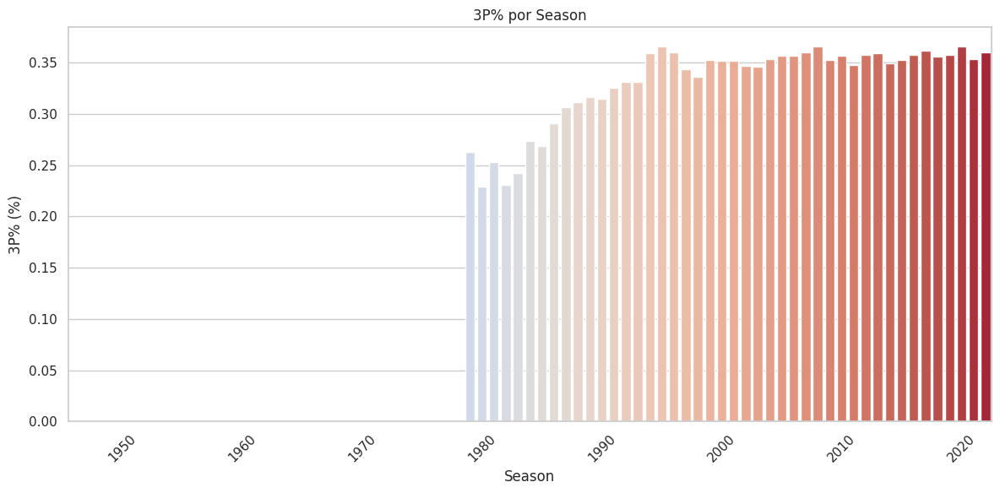

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np  # Importar numpy para usar np.mean

# Configuración para mejorar la estética de los gráficos
sns.set(style="whitegrid")

# Leer el archivo CSV
df = pd.read_csv('Final_BBDD.csv')

# Convertir 'Season' a un formato que pueda ser utilizado en gráficos
df['Season'] = df['Season'].apply(lambda x: int(x.split('-')[0]))

# Lista de variables para graficar
variables = ['TS%', 'eFG%', 'Total S%', 'ORB%', 'DRB%', 'TRB%', 'AST%', 'TOV%_x', 'STL%', 'BLK%', 'PPS', 'ORtg', 'DRtg', 'eDiff', 'Poss', 'Pace', 'FTA RATE', '3P%']

# Ajustar las marcas del eje x para mostrar solo décadas específicas
decades = range((df['Season'].min() // 10) * 10, (df['Season'].max() // 10) * 10 + 10, 10)

# Crear un gráfico de columnas para cada variable numérica con 'Season'
for variable in variables:
    plt.figure(figsize=(12, 6))
    # Cambiar estimator=sum a estimator=np.mean para calcular la media
    sns.barplot(x='Season', y=variable, data=df, ci=None, estimator=np.mean, palette="coolwarm")
    plt.title(f"{variable} por Season")
    plt.xlabel('Season')
    plt.ylabel(variable if variable not in ['3P%', 'eFG%', 'TS%', 'FTA RATE'] else variable + " (%)")

    # Ajustar las marcas del eje x para mostrar solo las décadas
    plt.xticks(ticks=[i for i, season in enumerate(sorted(df['Season'].unique())) if season in decades], labels=[str(decade) for decade in decades if decade in df['Season'].values])

    plt.xticks(rotation=45)  # Rotar las etiquetas del eje x para mejor legibilidad
    plt.tight_layout()  # Ajusta automáticamente los parámetros de la subtrama
    plt.show()


# **Informacion Genral**

In [ ]:
import pandas as pd

# Leer el archivo CSV
datos = pd.read_csv('Final_BBDD.csv')

# Número de observaciones y variables
num_observaciones = datos.shape[0]
num_variables = datos.shape[1]

# Crear una tabla con la información de las columnas
info_columnas = pd.DataFrame({
    'Columna': datos.columns,
    'Tipo de Dato': datos.dtypes,
    'Número de Observaciones': datos.notnull().sum(),  # Contar valores no nulos por columna
    'Ejemplo de Valor': datos.iloc[0]  # Muestra el primer valor de cada columna como ejemplo
})

# Mostrar la información general
print(f"Número de Observaciones: {num_observaciones}")
print(f"Número de Variables: {num_variables}")
print("\nInformación de las Columnas:")
print(info_columnas)
display(info_columnas)

Número de Observaciones: 1638
Número de Variables: 101

Información de las Columnas:
           Columna Tipo de Dato  Número de Observaciones Ejemplo de Valor
Team          Team       object                     1638           Boston
TS%            TS%      float64                     1638              0.6
eFG%          eFG%      float64                     1638            0.566
Total S%  Total S%      float64                     1638            166.4
ORB%          ORB%      float64                     1638             22.1
...            ...          ...                      ...              ...
AST/ OPP  AST/ OPP      float64                     1638             23.1
STL/ OPP  STL/ OPP      float64                     1638              6.6
BLK/ OPP  BLK/ OPP      float64                     1638              3.9
TO/ OPP    TO/ OPP      float64                     1638             12.0
PF/ OPP    PF/ OPP      float64                     1638             19.1

[101 rows x 4 columns]


,Columna,Tipo de Dato,Número de Observaciones,Ejemplo de Valor
Team,Team,object,1638,Boston
TS%,TS%,float64,1638,0.6
eFG%,eFG%,float64,1638,0.566
Total S%,Total S%,float64,1638,166.4
ORB%,ORB%,float64,1638,22.1
...,...,...,...,...
AST/ OPP,AST/ OPP,float64,1638,23.1
STL/ OPP,STL/ OPP,float64,1638,6.6
BLK/ OPP,BLK/ OPP,float64,1638,3.9
TO/ OPP,TO/ OPP,float64,1638,12.0


# **Tipo de variables e Intervalos con nueva BBDD**

In [ ]:
import pandas as pd

# Leer el archivo CSV
df = pd.read_csv('Final_BBDD.csv')

# Extraer el año inicial de la temporada
# Asumiendo que el formato es 'YYYY-YYYY'
df['Start_Year'] = df['Season'].apply(lambda x: int(x.split('-')[0]))

# Ordenar por el año inicial y calcular la diferencia entre años consecutivos
df = df.sort_values(by='Start_Year')
df['Year_Diff'] = df['Start_Year'].diff().fillna(0)  # Modificado para rellenar el primer valor NaN con 0

# Determinar la periodicidad más común
periodicidad = df['Year_Diff'].mode()[0]
print(f"La periodicidad estimada es: {periodicidad} años")

# Crear una lista para almacenar la información de cada variable
resumen_variables = []

# Para intervalos de cada variable
for columna in df.columns:
    info_variable = {"Variable": columna}
    if pd.api.types.is_numeric_dtype(df[columna]):
        minimo = df[columna].min()
        maximo = df[columna].max()
        info_variable["Tipo"] = "Numérico"
        info_variable["Intervalo"] = f"[{minimo}, {maximo}]"
        print(f"Variable '{columna}': Tipo Numérico, Intervalo [{minimo}, {maximo}]")
    elif pd.api.types.is_categorical_dtype(df[columna]) or df[columna].dtype == object:
        categorias = df[columna].unique()
        info_variable["Tipo"] = "Categórico"
        info_variable["Categorías"] = categorias
        print(f"Variable '{columna}': Tipo Categórico, Categorías {categorias}")
    resumen_variables.append(info_variable)

# Convertir la lista a DataFrame
df_resumen = pd.DataFrame(resumen_variables)
display(df_resumen)
# Exportar el resumen a un archivo CSV
df_resumen.to_csv('ResumenVariables.csv', index=False)
print("Resumen de variables exportado a 'ResumenVariables.csv'")


La periodicidad estimada es: 0.0 años
Variable 'Team': Tipo Categórico, Categorías ['Boston' 'Chicago' 'Washington' 'Providence' 'Cleveland' 'Pittsburgh'
 'St.Louis' 'Toronto' 'NewYork' 'Detroit' 'Philadelphia' 'Baltimore'
 'Rochester' 'Minneapolis' 'FortWayne' 'Indianapolis' 'Anderson'
 'Syracuse' 'Tri-Cities' 'Sheboygan' 'Waterloo' 'Milwaukee' 'Cincinnati'
 'L.A.Lakers' 'GoldenState' 'Seattle' 'SanDiego' 'Phoenix' 'Atlanta'
 'Portland' 'Buffalo' 'Houston' 'KansasCity' 'NewOrleans' 'Denver'
 'SanAntonio' 'Indiana' 'NewJersey' 'Utah' 'Dallas' 'L.A.Clippers'
 'Sacramento' 'Miami' 'Charlotte' 'Orlando' 'Minnesota' 'Vancouver'
 'Memphis' 'OklahomaCity' 'Brooklyn']
Variable 'TS%': Tipo Numérico, Intervalo [0.2920927313669755, 0.61]
Variable 'eFG%': Tipo Numérico, Intervalo [0.2464065708418891, 0.575]
Variable 'Total S%': Tipo Numérico, Intervalo [114.0, 173.2]
Variable 'ORB%': Tipo Numérico, Intervalo [17.9, 39.1]
Variable 'DRB%': Tipo Numérico, Intervalo [61.5, 81.7]
Variable 'TRB%': Tipo

,Variable,Tipo,Categorías,Intervalo
0,Team,Categórico,"[Boston, Chicago, Washington, Providence, Clev...",NaN
1,TS%,Numérico,NaN,"[0.2920927313669755, 0.61]"
2,eFG%,Numérico,NaN,"[0.2464065708418891, 0.575]"
3,Total S%,Numérico,NaN,"[114.0, 173.2]"
4,ORB%,Numérico,NaN,"[17.9, 39.1]"
...,...,...,...,...
98,BLK/ OPP,Numérico,NaN,"[-1.7, 6.9]"
99,TO/ OPP,Numérico,NaN,"[-2.9, 18.6]"
100,PF/ OPP,Numérico,NaN,"[-3.5, 25.7]"
101,Start_Year,Numérico,NaN,"[1946, 2022]"


Resumen de variables exportado a 'ResumenVariables.csv'


# **Medias nueva BBDD**

In [ ]:
# Leer el archivo CSV
df = pd.read_csv('Final_BBDD.csv')

# Crear un DataFrame vacío para almacenar los resultados
resultados = pd.DataFrame(columns=['Columna', 'Media', 'Mediana', 'Moda', 'Rango', 'Varianza', 'Desviación Estándar', 'IQR'])

# Bucle para cada columna numérica en el DataFrame
for columna in df.select_dtypes(include=['number']).columns:
    # Calcular las estadísticas
    media = df[columna].mean()
    mediana = df[columna].median()
    moda = df[columna].mode()[0] if not df[columna].mode().empty else None
    rango = df[columna].max() - df[columna].min()
    varianza = df[columna].var()
    desviacion_estandar = df[columna].std()
    IQR = df[columna].quantile(0.75) - df[columna].quantile(0.25)

    # Crear un DataFrame temporal para los resultados actuales
    resultados_temp = pd.DataFrame({
        'Columna': [columna],
        'Media': [media],
        'Mediana': [mediana],
        'Moda': [moda],
        'Rango': [rango],
        'Varianza': [varianza],
        'Desviación Estándar': [desviacion_estandar],
        'IQR': [IQR]
    })

    # Concatenar con el DataFrame de resultados
    resultados = pd.concat([resultados, resultados_temp], ignore_index=True)

# Mostrar el DataFrame de resultados
#print(resultados)
display(resultados)

,Columna,Media,Mediana,Moda,Rango,Varianza,Desviación Estándar,IQR
0,TS%,0.522889,0.530000,0.535000,0.317907,0.001735,0.041654,0.038000
1,eFG%,0.477352,0.485000,0.487000,0.328593,0.002259,0.047525,0.040000
2,Total S%,152.309044,153.200000,152.309044,59.200000,103.224282,10.159935,6.600000
3,ORB%,28.735730,28.735730,28.735730,21.200000,14.995527,3.872406,4.800000
4,DRB%,71.229726,71.229726,71.229726,20.200000,13.115833,3.621579,4.900000
...,...,...,...,...,...,...,...,...
94,AST/ OPP,21.447032,21.447032,21.447032,32.300000,10.339912,3.215573,0.052968
95,STL/ OPP,7.222527,7.222527,7.222527,11.700000,1.175422,1.084169,0.077473
96,BLK/ OPP,4.643683,4.643683,4.643683,8.600000,0.599375,0.774193,0.000000
97,TO/ OPP,13.398478,13.398478,13.398478,21.500000,3.936823,1.984143,0.101522


# **Diagrama de dispersión nueva BDDD**

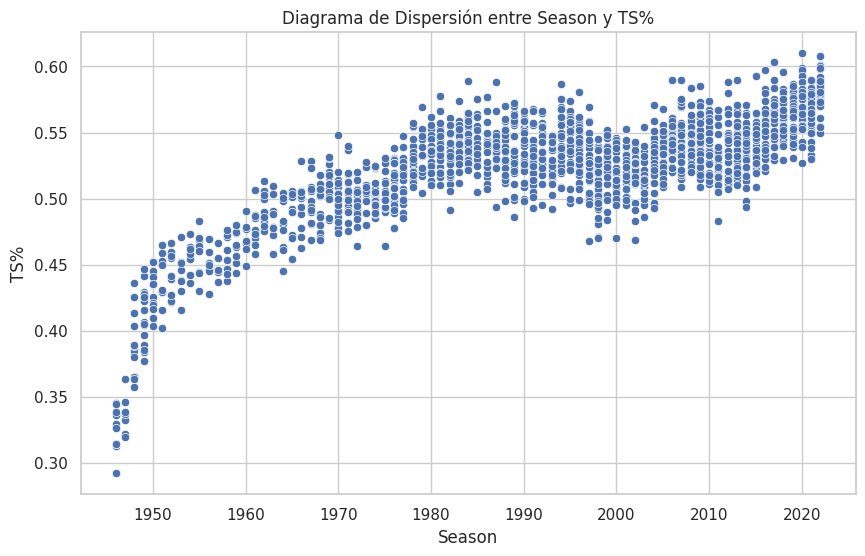

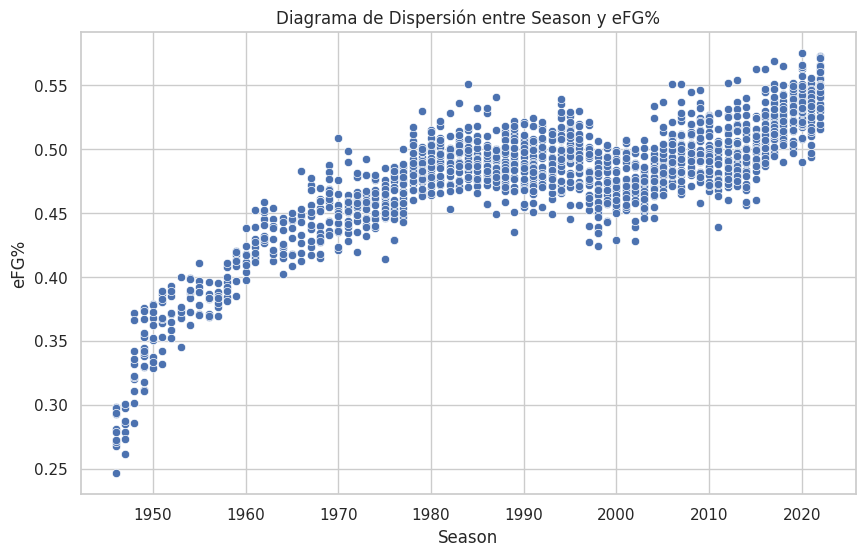

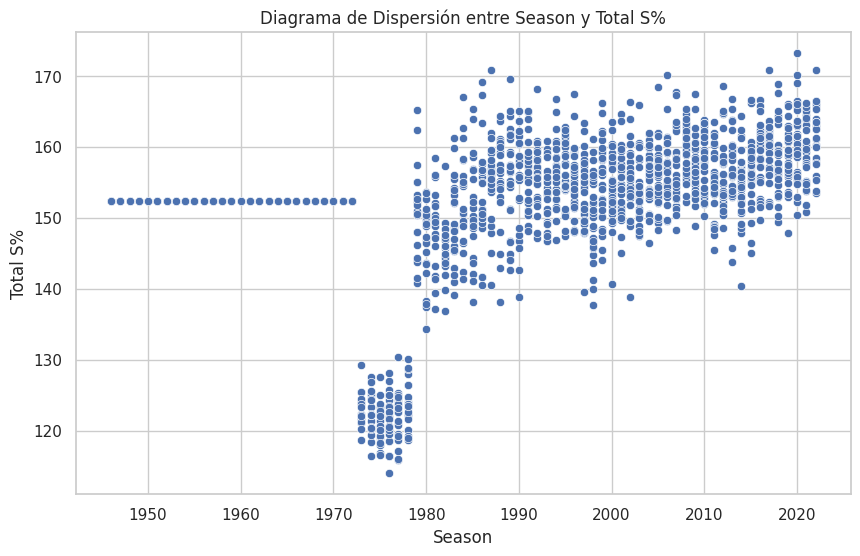

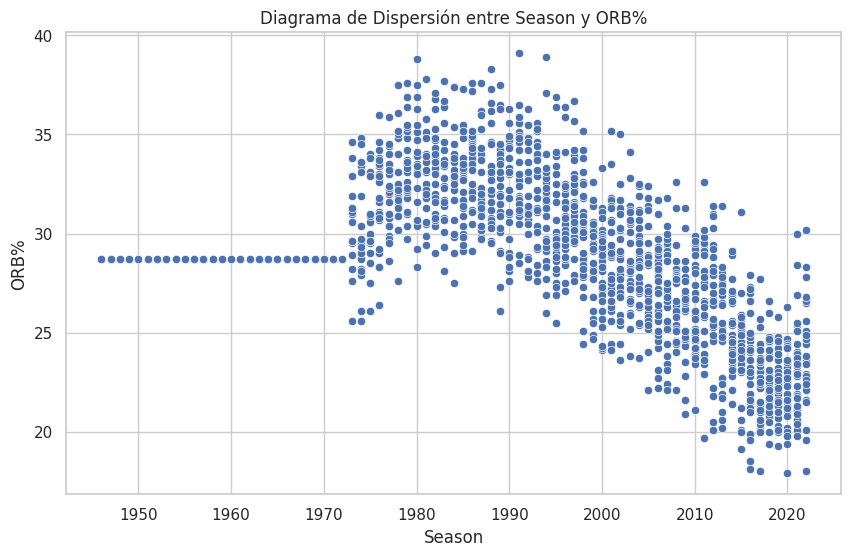

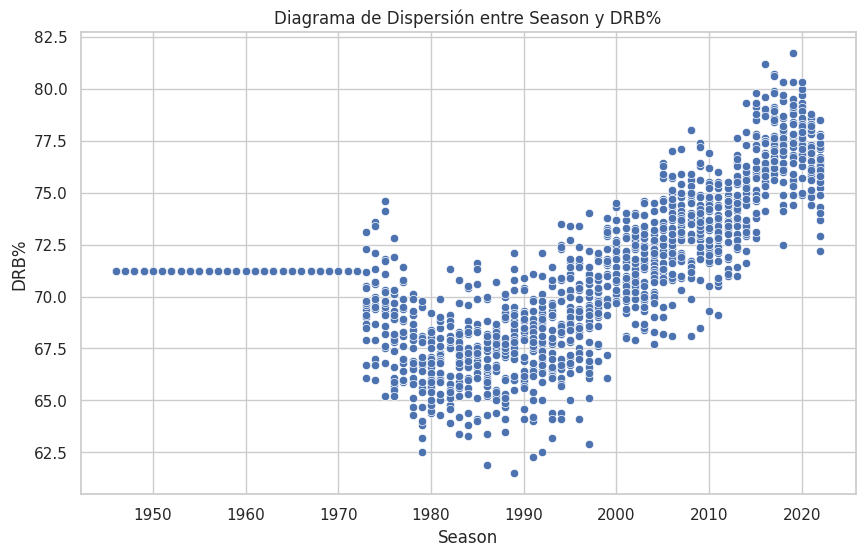

...

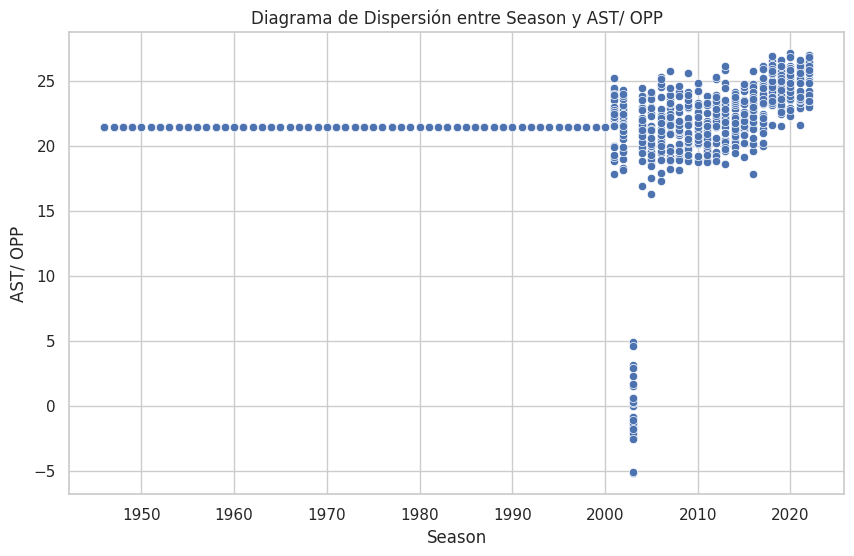

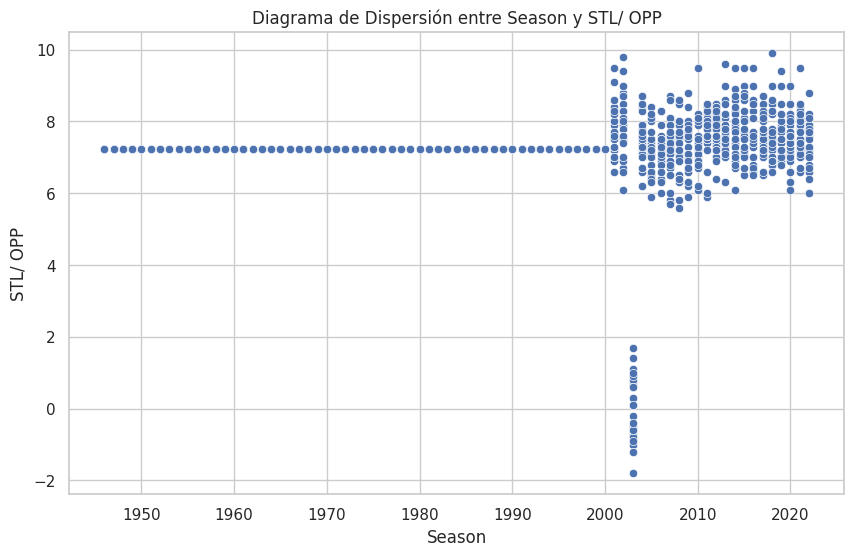

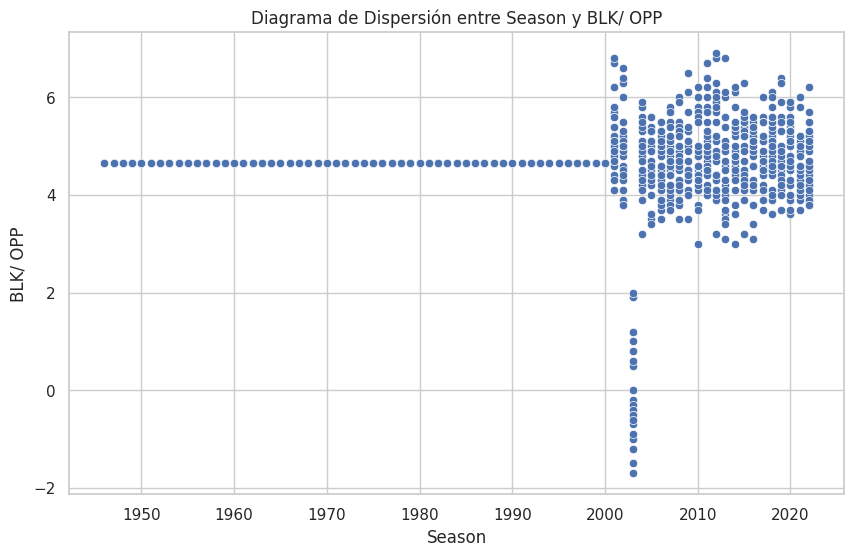

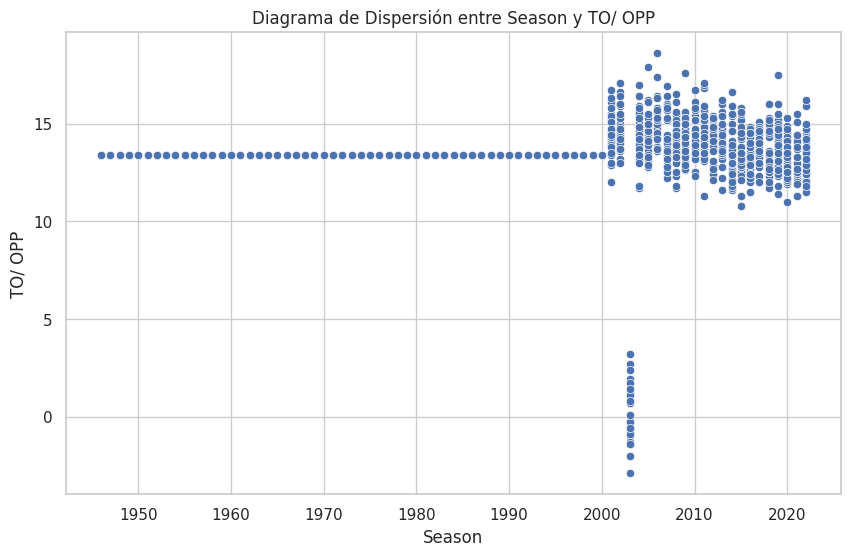

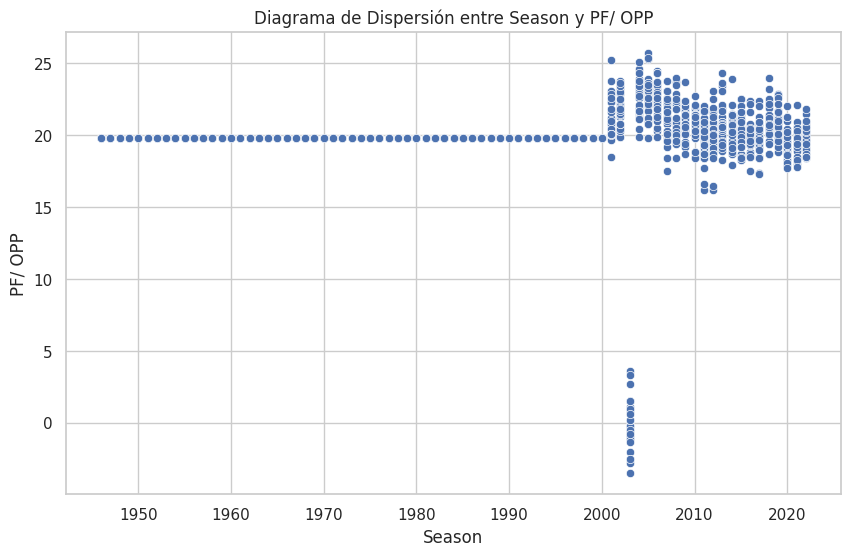

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Leer el archivo CSV
df = pd.read_csv('Final_BBDD.csv')

# Convertir 'Season' a un formato que pueda ser utilizado en gráficos
# Aquí asumimos que 'Season' es una cadena como '2022-2023' y tomamos el primer año
df['Season'] = df['Season'].apply(lambda x: int(x.split('-')[0]))

# Seleccionar las columnas numéricas, excluyendo 'Season' si es numérica
columnas_numericas = df.select_dtypes(include=['number']).columns.drop('Season')

# Crear un diagrama de dispersión para cada variable numérica con 'Season'
for columna in columnas_numericas:
    plt.figure(figsize=(10, 6))
    sns.scatterplot(x='Season', y=columna, data=df)
    plt.title(f"Diagrama de Dispersión entre Season y {columna}")
    plt.xlabel('Season')
    plt.ylabel(columna)
    plt.show()

# **Diagrama de Cajas Nueva BBDD**

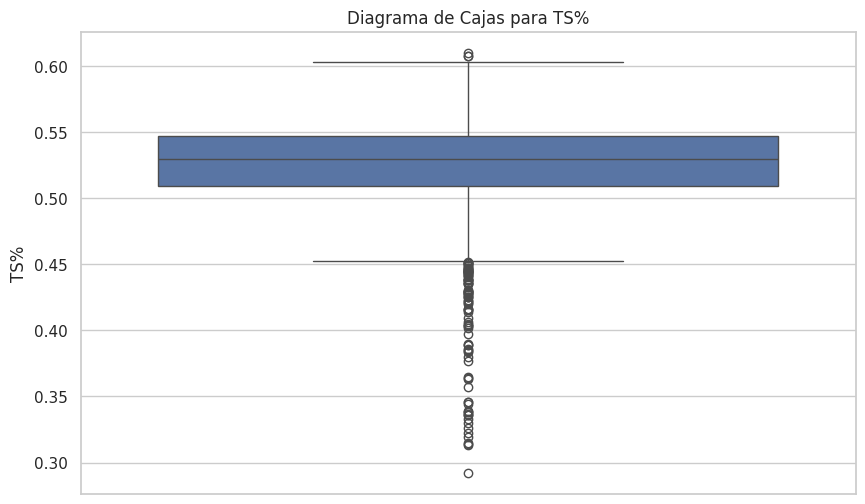

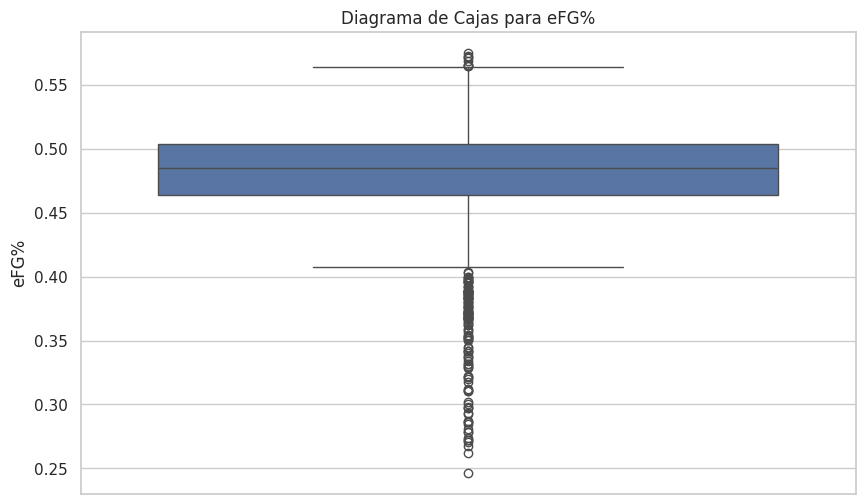

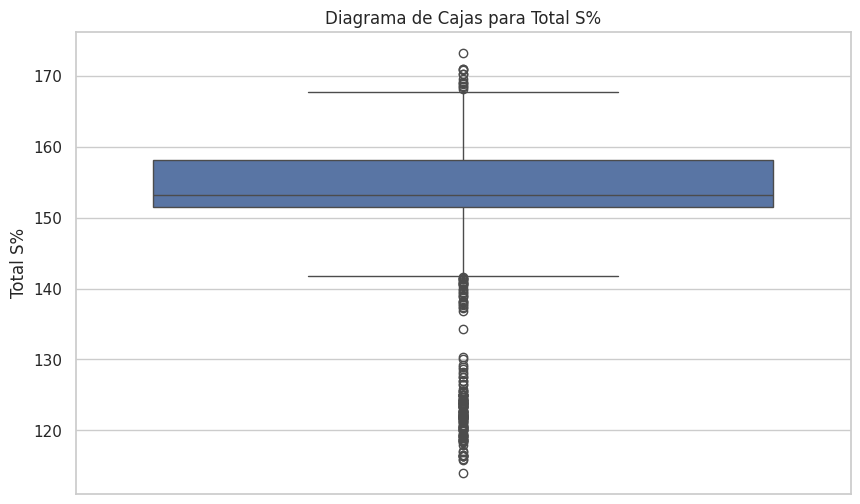

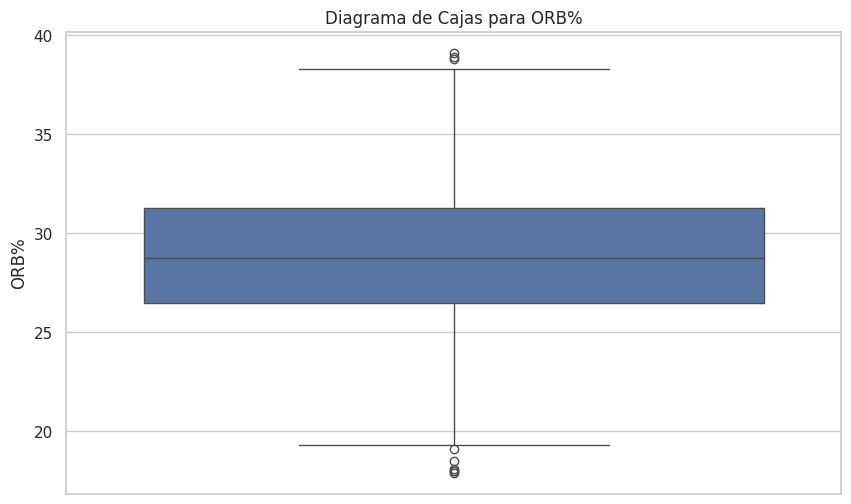

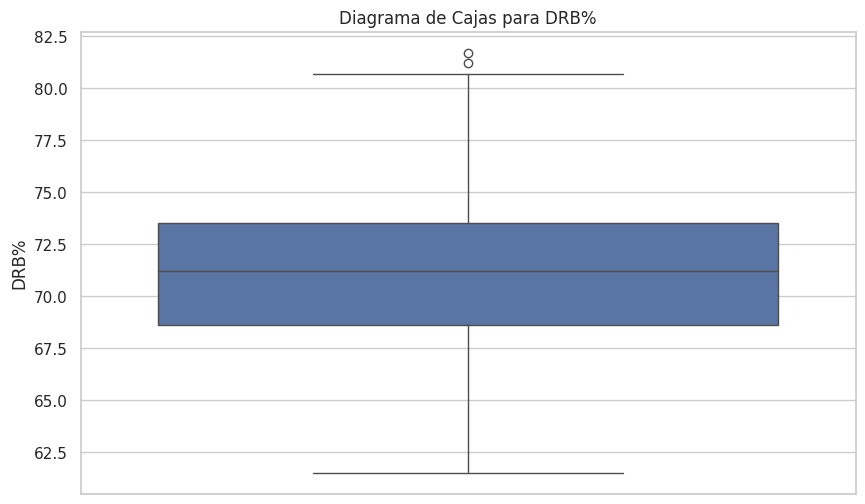

...

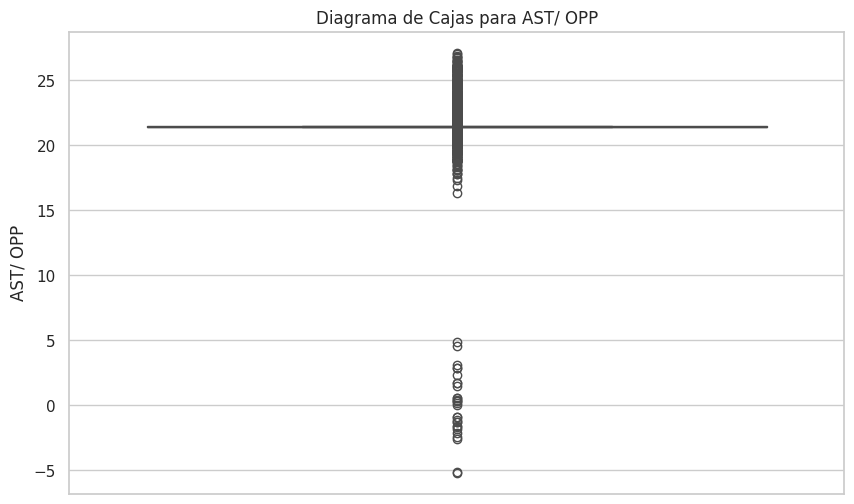

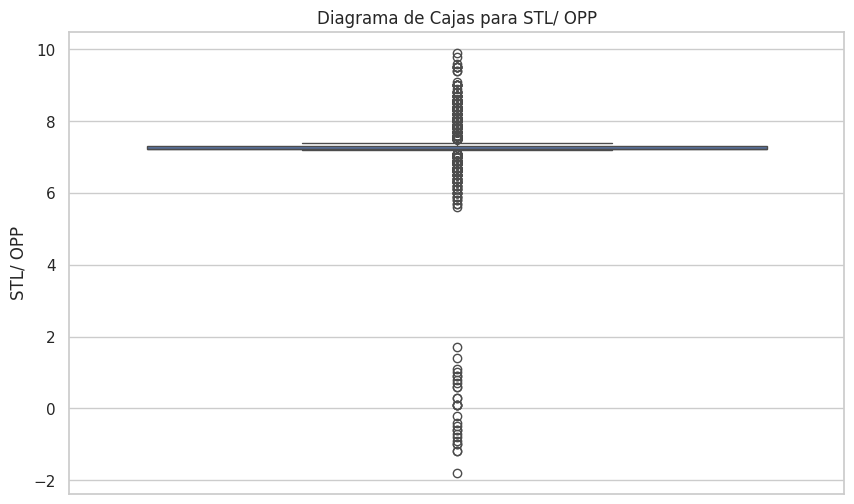

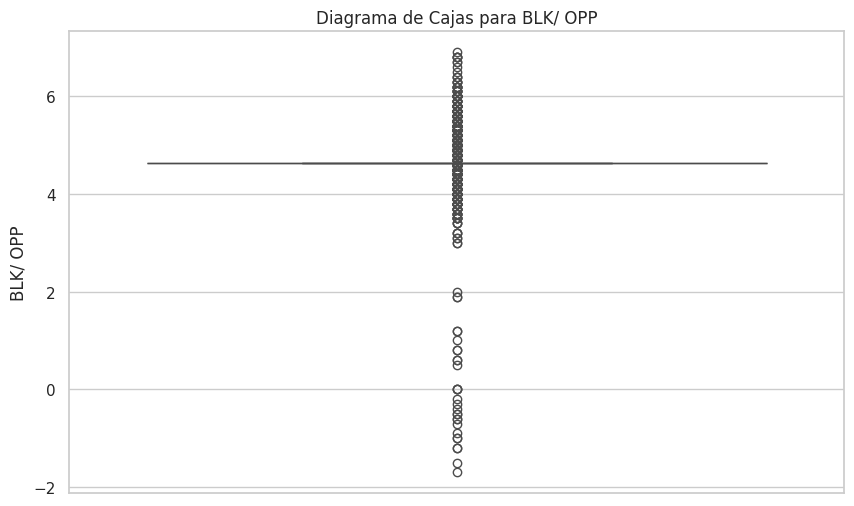

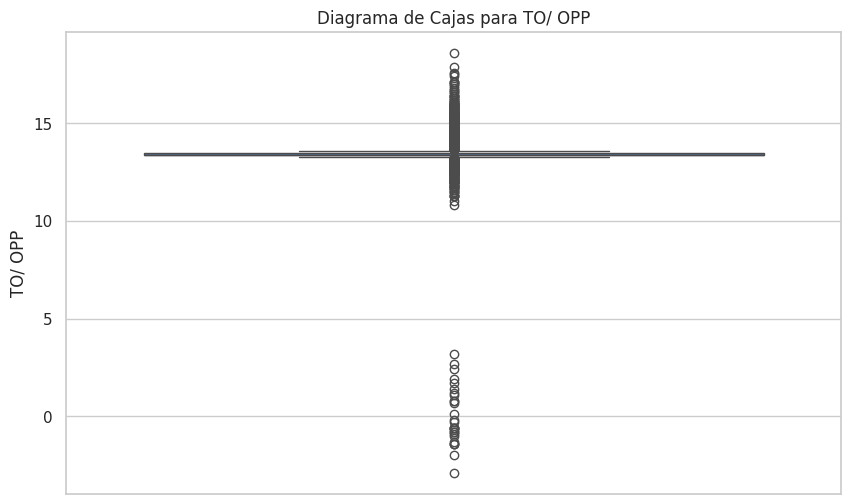

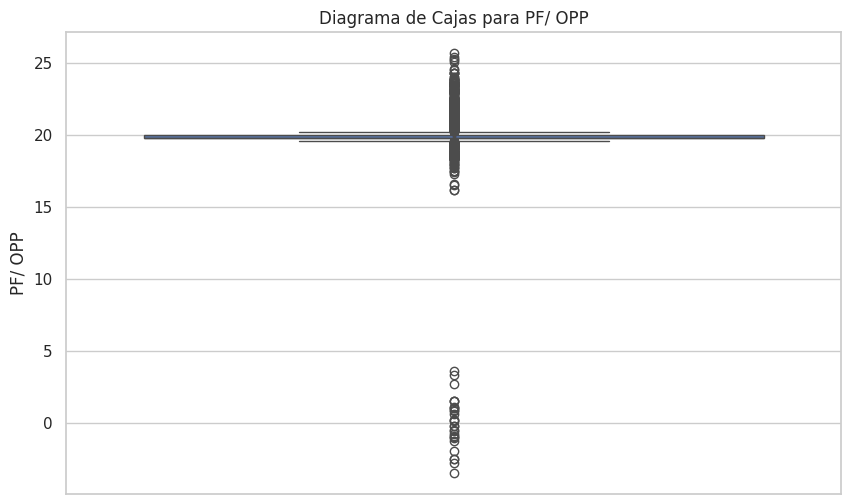

In [ ]:
# Crear un diagrama de cajas para cada variable numérica
for columna in columnas_numericas:
    plt.figure(figsize=(10, 6))
    sns.boxplot(y=df[columna])
    plt.title(f"Diagrama de Cajas para {columna}")
    plt.ylabel(columna)
    plt.show()

# **Outliers Nueva BBDD**

In [ ]:
# Leer el archivo CSV
df = pd.read_csv('Final_BBDD.csv')

# Seleccionar las columnas numéricas
columnas_numericas = df.select_dtypes(include=['number']).columns

# Crear un DataFrame para almacenar los outliers
outliers = pd.DataFrame(columns=['Columna', 'Outliers'])

for columna in columnas_numericas:
    Q1 = df[columna].quantile(0.25)
    Q3 = df[columna].quantile(0.75)
    IQR = Q3 - Q1
    filtro = ((df[columna] < (Q1 - 1.5 * IQR)) | (df[columna] > (Q3 + 1.5 * IQR)))

    # Agregar los outliers al DataFrame
    outliers = pd.concat([outliers, pd.DataFrame({'Columna': [columna], 'Outliers': [df[columna][filtro].tolist()]})], ignore_index=True)

# Mostrar la tabla de outliers
display(outliers)

,Columna,Outliers
0,TS%,"[0.608, 0.608, 0.61, 0.4454211713987404, 0.448..."
1,eFG%,"[0.566, 0.573, 0.572, 0.571, 0.565, 0.566, 0.5..."
2,Total S%,"[170.9, 173.2, 170.2, 169.0, 168.9, 170.9, 140..."
3,ORB%,"[18.0, 17.9, 18.0, 18.5, 18.1, 19.1, 38.9, 39...."
4,DRB%,"[81.7, 81.2]"
...,...,...
94,AST/ OPP,"[23.1, 23.0, 24.2, 26.4, 23.9, 25.7, 25.1, 26...."
95,STL/ OPP,"[6.6, 7.0, 6.6, 6.8, 7.0, 7.9, 6.0, 7.9, 6.0, ..."
96,BLK/ OPP,"[3.9, 4.4, 4.6, 5.2, 3.9, 4.2, 4.5, 4.2, 4.0, ..."
97,TO/ OPP,"[12.0, 14.7, 14.4, 11.5, 12.9, 12.0, 14.3, 15...."


# **Matriz Correlación**

<ipython-input-2-8f6deba2d690>:7: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  matriz_correlacion = df.corr()


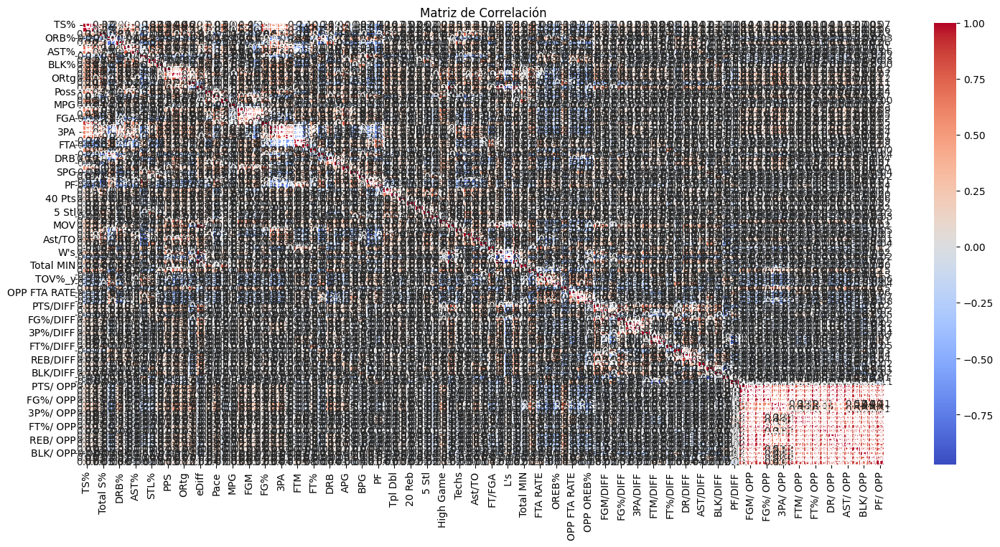

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

df = pd.read_csv('Final_BBDD.csv')

matriz_correlacion = df.corr()

plt.figure(figsize=(18, 8))  # Ajusta el tamaño del gráfico según necesites
sns.heatmap(matriz_correlacion, annot=True, fmt=".2f", cmap='coolwarm', linewidths=.5)
plt.title('Matriz de Correlación')
plt.show()


In [ ]:
import pandas as pd

# Paso 1: Leer el archivo CSV
df = pd.read_csv('Final_BBDD.csv')

# Paso 2: Convertir las columnas a numérico (esto es un ejemplo, ajusta según tus datos)
# Suponiendo que 'Win %' y 'MOV' ya están en formato adecuado, si no, deberías convertirlos también
for col in df.columns:
    df[col] = pd.to_numeric(df[col], errors='coerce')

# Paso 3: Calcular la matriz de correlación completa
correlation_matrix = df.corr()

# Paso 4: Filtrar la matriz de correlación para 'Win %' y 'MOV'
win_percentage_corr = correlation_matrix['Win %'].sort_values(ascending=False)
mov_corr = correlation_matrix['MOV'].sort_values(ascending=False)

# Mostrar las correlaciones
print("Correlación con Win %:")
print(win_percentage_corr)
print("\nCorrelación con MOV:")
print(mov_corr)


Correlación con Win %:
Win %       1.000000
W's         0.972830
eDiff       0.963237
MOV         0.901673
PTS/DIFF    0.632594
              ...   
OPP EFG%   -0.325587
DRtg       -0.464836
L's        -0.971316
Team             NaN
Season           NaN
Name: Win %, Length: 101, dtype: float64

Correlación con MOV:
MOV         1.000000
eDiff       0.947549
Win %       0.901673
W's         0.875350
PTS/DIFF    0.706988
              ...   
OPP EFG%   -0.350827
DRtg       -0.452783
L's        -0.872593
Team             NaN
Season           NaN
Name: MOV, Length: 101, dtype: float64


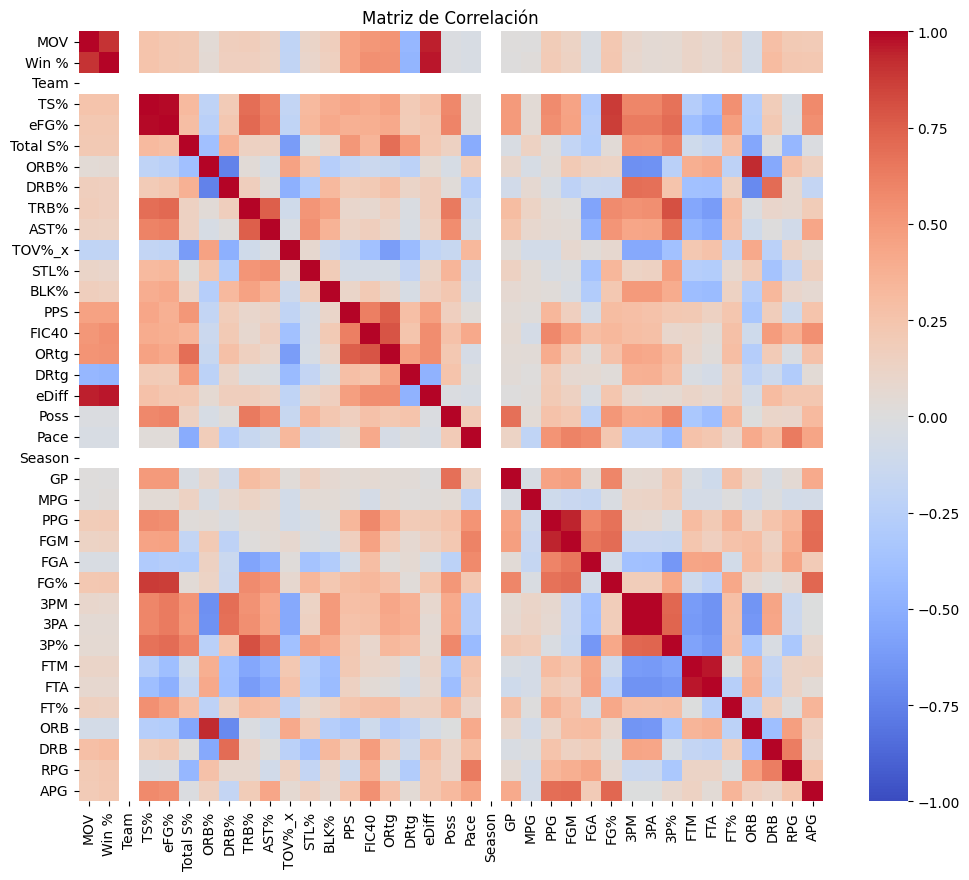

In [ ]:
import pandas as pd

# Paso 1: Leer el archivo CSV
df = pd.read_csv('Final_BBDD.csv')

# Convertir todas las columnas a numérico, si es necesario
for col in df.columns:
    df[col] = pd.to_numeric(df[col], errors='coerce')

# Seleccionar las primeras 50 columnas numéricas, asegurándose de incluir 'Win %' y 'MOV'
num_cols = df.select_dtypes(include=['float64', 'int64']).columns
if 'Win %' not in num_cols[:35]:
    num_cols = num_cols.insert(0, 'Win %')
if 'MOV' not in num_cols[:35]:
    num_cols = num_cols.insert(0, 'MOV')

df_filtered = df[num_cols[:37]]  # Ajustado para incluir 'Win %' y 'MOV' si no estaban en las primeras 50

# Calcular la matriz de correlación para el subconjunto
correlation_matrix = df_filtered.corr()

# Visualizar la matriz de correlación completa para este subconjunto
plt.figure(figsize=(12, 10))
sns.heatmap(correlation_matrix, annot=False, cmap='coolwarm', vmin=-1, vmax=1)
plt.title('Matriz de Correlación')
plt.show()